Thống kê mô tả trên toàn bộ dữ liệu:
AQI: Mean = 54.73, Std = 27.86, Min = 6.00, Max = 172.00, Exceedance_Rate = 7.27%
PM2.5: Mean = 51.65, Std = 29.14, Min = 1.28, Max = 172.20, Exceedance_Rate = nan%
PM10: Mean = 43.87, Std = 22.84, Min = 1.49, Max = 167.59, Exceedance_Rate = nan%
CO: Mean = 12.14, Std = 7.89, Min = 0.03, Max = 59.04, Exceedance_Rate = nan%
NO2: Mean = 8.10, Std = 9.83, Min = 0.04, Max = 76.23, Exceedance_Rate = nan%
O3: Mean = 15.98, Std = 17.01, Min = 0.43, Max = 177.59, Exceedance_Rate = nan%
SO2: Mean = 5.60, Std = 6.22, Min = 0.40, Max = 54.84, Exceedance_Rate = nan%

Thống kê mô tả theo khung giờ (một số giờ mẫu):
      Mean_AQI  Std_AQI  Min_AQI  Max_AQI  Mean_PM2.5  Std_PM2.5  Min_PM2.5  \
Hour                                                                          
0        54.42    28.05      7.0    157.0       51.65      28.66       5.55   
1        53.28    27.16      6.0    159.0       49.74      28.09       4.22   
2        55.11    27.15      7.0    1

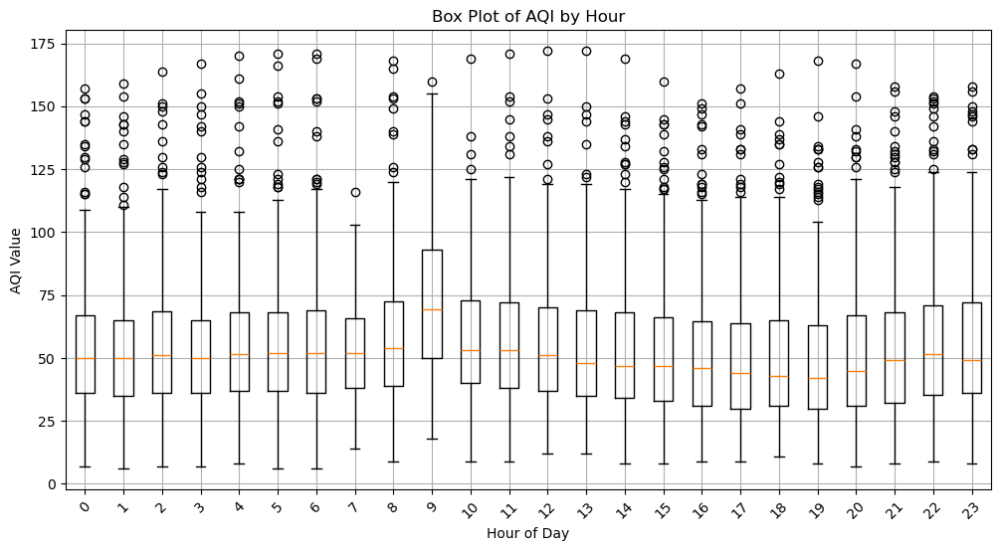

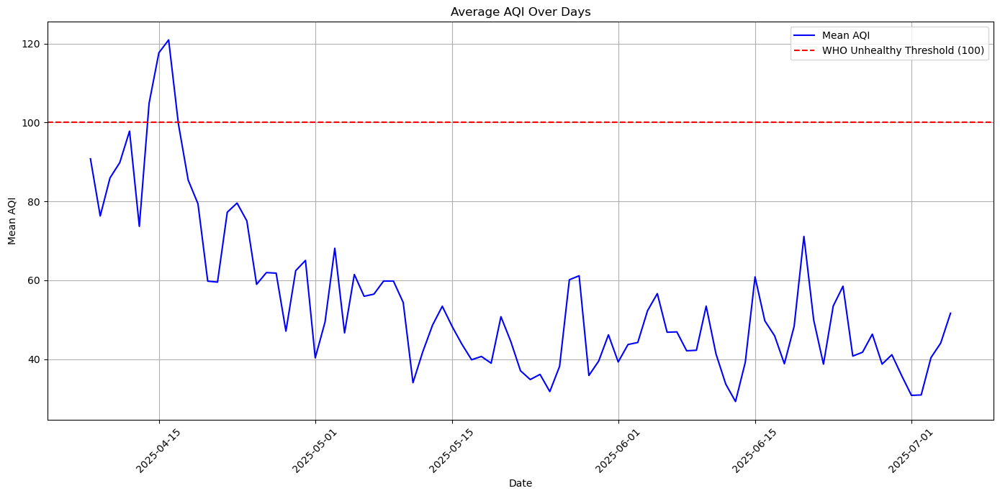

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

# Tạo thư mục output/overall_stats nếu chưa tồn tại
output_dir = 'output/overall_stats'
os.makedirs(output_dir, exist_ok=True)

# Đọc dữ liệu
df = pd.read_csv('./air_quality_weather_data_filtered.csv', parse_dates=['Timestamp'], dayfirst=True)

# Chuyển các cột chỉ số môi trường về dạng số, thay thế giá trị không hợp lệ bằng NaN
columns_to_numeric = ['AQI', 'PM2.5', 'PM10', 'CO', 'NO2', 'O3', 'SO2', 'Temperature', 'Humidity', 'Pressure', 'Wind Speed']
for col in columns_to_numeric:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Loại bỏ các hàng có giá trị NaN trong các cột chỉ số chính
df = df.dropna(subset=columns_to_numeric)

# Thêm cột 'Hour' và 'Date' để phân tích theo khung giờ và ngày
df['Hour'] = df['Timestamp'].dt.hour
df['Date'] = df['Timestamp'].dt.date

# Danh sách các chỉ số môi trường để phân tích
environmental_indicators = ['AQI', 'PM2.5', 'PM10', 'CO', 'NO2', 'O3', 'SO2']

# Hàm tính tần suất vượt ngưỡng AQI > 100
def calculate_exceedance_rate(data):
    if len(data) == 0:
        return 0.0
    return (data > 100).mean() * 100  # Phần trăm vượt ngưỡng

# Thống kê mô tả trên toàn bộ dữ liệu
overall_stats = {}
for indicator in environmental_indicators:
    stats = {
        'Mean': df[indicator].mean(),
        'Std': df[indicator].std(),
        'Min': df[indicator].min(),
        'Max': df[indicator].max(),
        'Exceedance_Rate (%)': calculate_exceedance_rate(df[indicator]) if indicator == 'AQI' else np.nan
    }
    overall_stats[indicator] = stats

# Thống kê mô tả theo khung giờ
stats_by_hour = df.groupby('Hour')[environmental_indicators].agg(['mean', 'std', 'min', 'max']).round(2)
stats_by_hour['Exceedance_Rate (%)'] = df.groupby('Hour')['AQI'].apply(calculate_exceedance_rate).round(2)

# Thống kê mô tả theo ngày
stats_by_date = df.groupby('Date')[environmental_indicators].agg(['mean', 'std', 'min', 'max']).round(2)
stats_by_date['Exceedance_Rate (%)'] = df.groupby('Date')['AQI'].apply(calculate_exceedance_rate).round(2)

# Đổi tên cột cho rõ ràng (thêm hậu tố để tránh trùng lặp)
stats_by_hour.columns = [f'{col[0]}_{col[1]}' if col[1] else col[0] for col in stats_by_hour.columns]
stats_by_hour = stats_by_hour.rename(columns={
    'AQI_mean': 'Mean_AQI', 'AQI_std': 'Std_AQI', 'AQI_min': 'Min_AQI', 'AQI_max': 'Max_AQI',
    'PM2.5_mean': 'Mean_PM2.5', 'PM2.5_std': 'Std_PM2.5', 'PM2.5_min': 'Min_PM2.5', 'PM2.5_max': 'Max_PM2.5',
    'PM10_mean': 'Mean_PM10', 'PM10_std': 'Std_PM10', 'PM10_min': 'Min_PM10', 'PM10_max': 'Max_PM10',
    'CO_mean': 'Mean_CO', 'CO_std': 'Std_CO', 'CO_min': 'Min_CO', 'CO_max': 'Max_CO',
    'NO2_mean': 'Mean_NO2', 'NO2_std': 'Std_NO2', 'NO2_min': 'Min_NO2', 'NO2_max': 'Max_NO2',
    'O3_mean': 'Mean_O3', 'O3_std': 'Std_O3', 'O3_min': 'Min_O3', 'O3_max': 'Max_O3',
    'SO2_mean': 'Mean_SO2', 'SO2_std': 'Std_SO2', 'SO2_min': 'Min_SO2', 'SO2_max': 'Max_SO2'
})
stats_by_hour['Exceedance_Rate (%)'] = stats_by_hour['Exceedance_Rate (%)']

# Đổi tên cột cho stats_by_date tương tự
stats_by_date.columns = [f'{col[0]}_{col[1]}' if col[1] else col[0] for col in stats_by_date.columns]
stats_by_date = stats_by_date.rename(columns={
    'AQI_mean': 'Mean_AQI', 'AQI_std': 'Std_AQI', 'AQI_min': 'Min_AQI', 'AQI_max': 'Max_AQI',
    'PM2.5_mean': 'Mean_PM2.5', 'PM2.5_std': 'Std_PM2.5', 'PM2.5_min': 'Min_PM2.5', 'PM2.5_max': 'Max_PM2.5',
    'PM10_mean': 'Mean_PM10', 'PM10_std': 'Std_PM10', 'PM10_min': 'Min_PM10', 'PM10_max': 'Max_PM10',
    'CO_mean': 'Mean_CO', 'CO_std': 'Std_CO', 'CO_min': 'Min_CO', 'CO_max': 'Max_CO',
    'NO2_mean': 'Mean_NO2', 'NO2_std': 'Std_NO2', 'NO2_min': 'Min_NO2', 'NO2_max': 'Max_NO2',
    'O3_mean': 'Mean_O3', 'O3_std': 'Std_O3', 'O3_min': 'Min_O3', 'O3_max': 'Max_O3',
    'SO2_mean': 'Mean_SO2', 'SO2_std': 'Std_SO2', 'SO2_min': 'Min_SO2', 'SO2_max': 'Max_SO2'
})
stats_by_date['Exceedance_Rate (%)'] = stats_by_date['Exceedance_Rate (%)']

# Lưu kết quả thống kê vào file CSV trong thư mục output/overall_stats
overall_stats_df = pd.DataFrame(overall_stats).T
overall_stats_df.to_csv(os.path.join(output_dir, 'overall_stats.csv'), index_label='Indicator')
stats_by_hour.to_csv(os.path.join(output_dir, 'stats_by_hour.csv'))
stats_by_date.to_csv(os.path.join(output_dir, 'stats_by_date.csv'))

# In kết quả
print("Thống kê mô tả trên toàn bộ dữ liệu:")
for indicator, stats in overall_stats.items():
    print(f"{indicator}: Mean = {stats['Mean']:.2f}, Std = {stats['Std']:.2f}, "
          f"Min = {stats['Min']:.2f}, Max = {stats['Max']:.2f}, "
          f"Exceedance_Rate = {stats['Exceedance_Rate (%)']:.2f}%")

print("\nThống kê mô tả theo khung giờ (một số giờ mẫu):")
print(stats_by_hour.head())

print("\nThống kê mô tả theo ngày (một số ngày mẫu):")
print(stats_by_date.head())

# Kiểm tra số lượng dữ liệu hợp lệ
total_valid_count = df[environmental_indicators].count().sum()
print(f"\nTổng số lượng giá trị hợp lệ: {total_valid_count}")

# Vẽ và lưu biểu đồ hộp (box plot) cho AQI theo khung giờ
plt.figure(figsize=(12, 6))
hourly_aqi = df.groupby('Hour')['AQI'].apply(list)
plt.boxplot([data for data in hourly_aqi if len(data) > 0], labels=range(24))
plt.title('Box Plot of AQI by Hour')
plt.xlabel('Hour of Day')
plt.ylabel('AQI Value')
plt.xticks(rotation=45)
plt.grid(True)
plt.savefig(os.path.join(output_dir, 'aqi_boxplot_by_hour.png'))
plt.show()

# Vẽ và lưu biểu đồ đường trung bình AQI theo ngày
plt.figure(figsize=(14, 7))
daily_mean_aqi = df.groupby('Date')['AQI'].mean()
plt.plot(daily_mean_aqi.index, daily_mean_aqi.values, label='Mean AQI', color='blue')
plt.axhline(y=100, color='red', linestyle='--', label='WHO Unhealthy Threshold (100)')
plt.title('Average AQI Over Days')
plt.xlabel('Date')
plt.ylabel('Mean AQI')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, 'aqi_trend_by_date.png'))
plt.show()

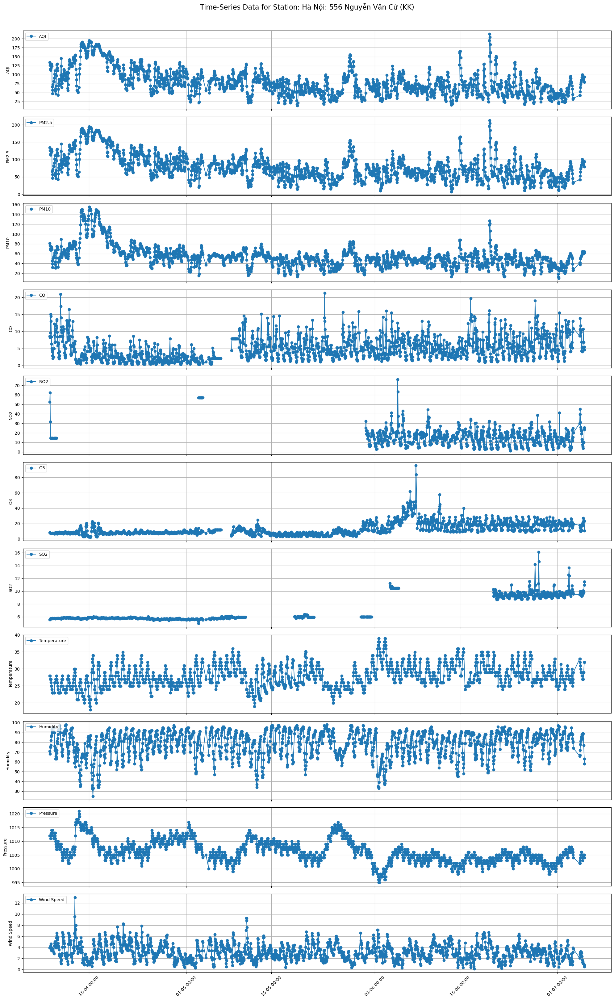

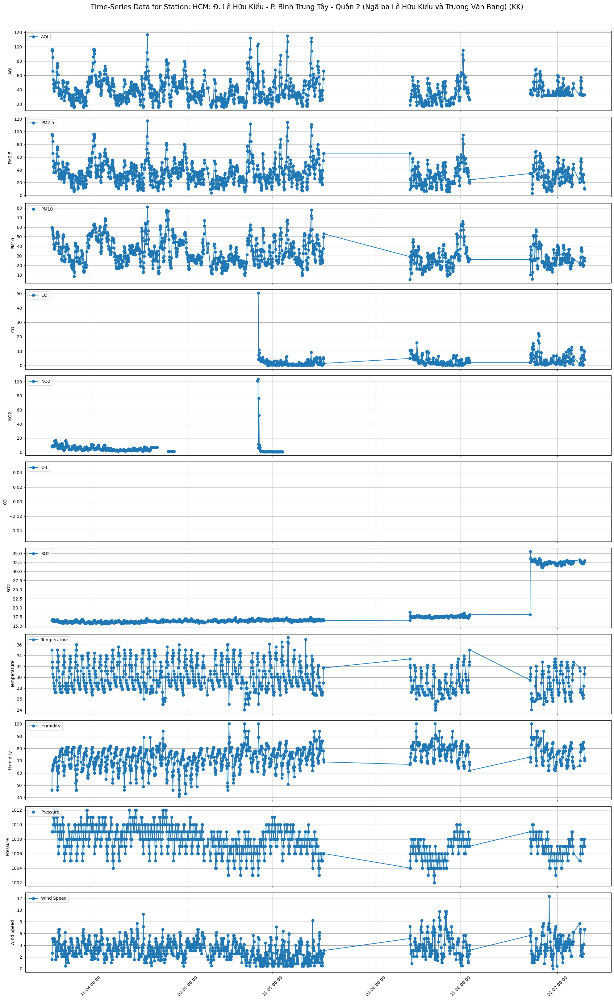

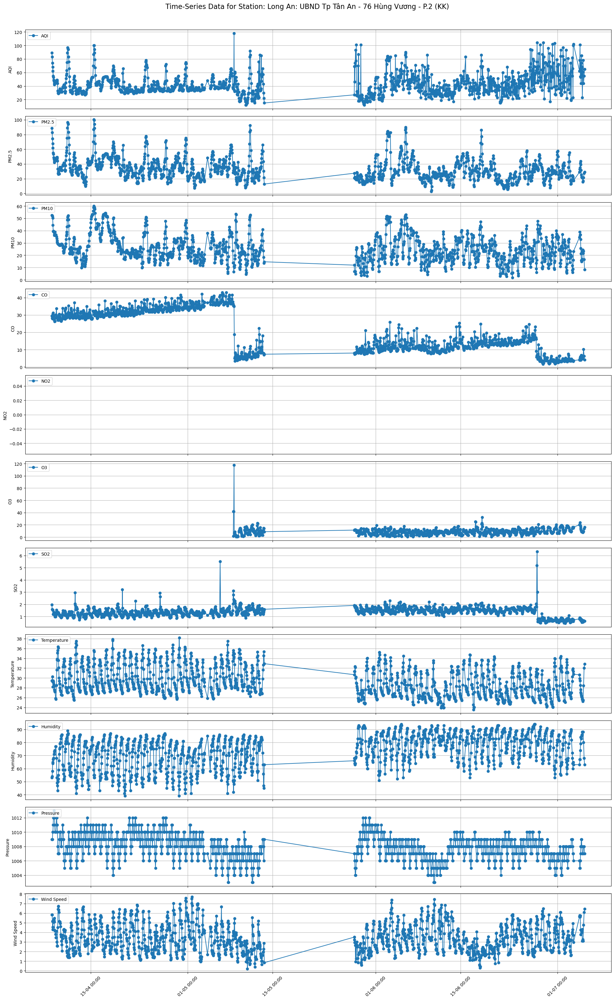

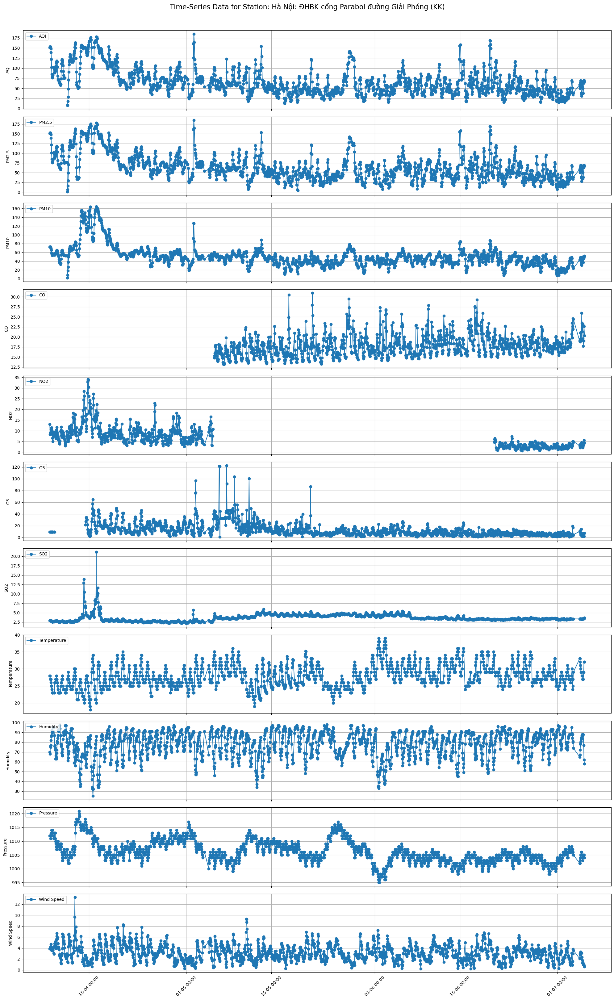

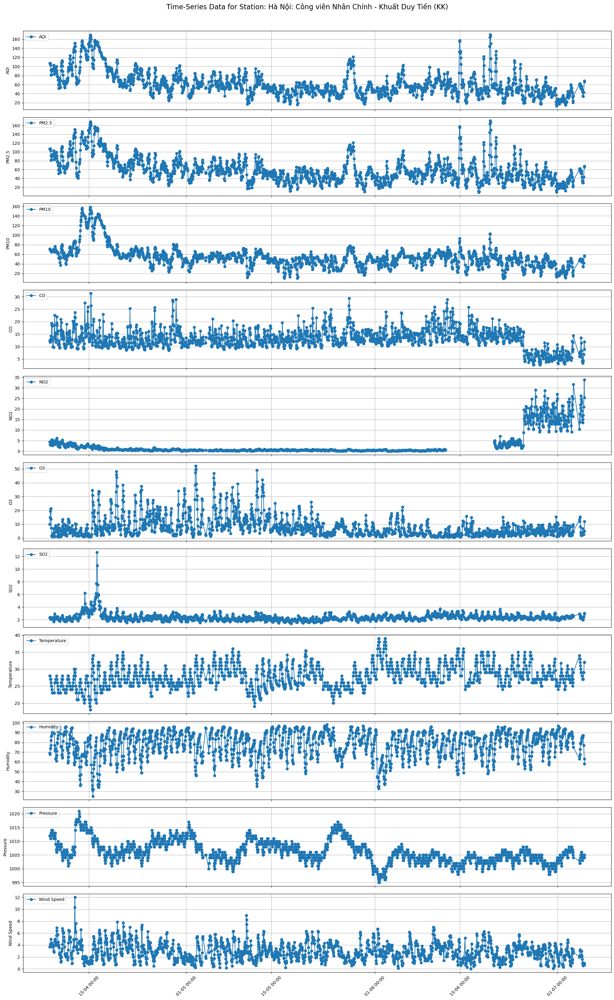

...

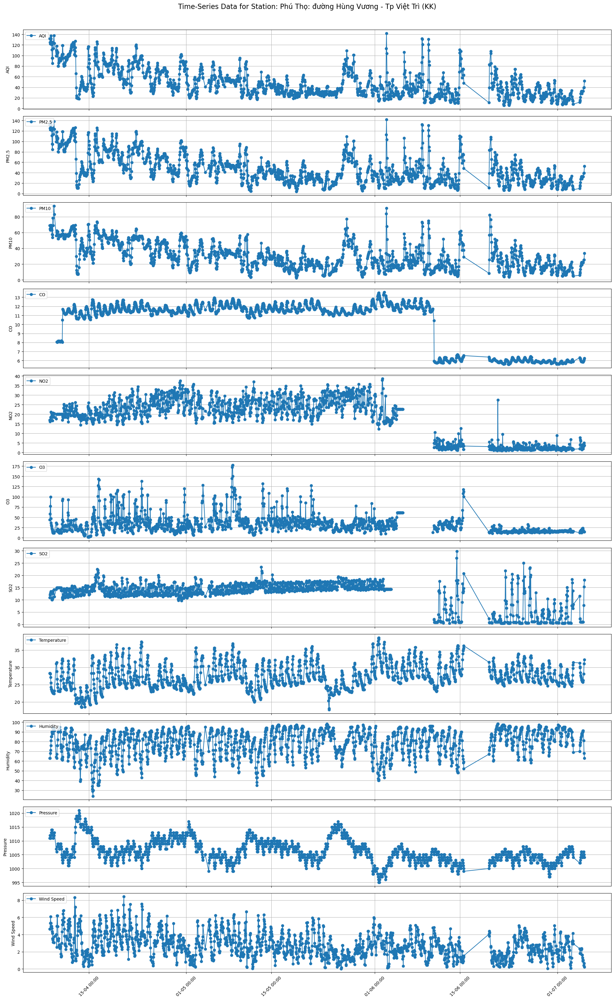

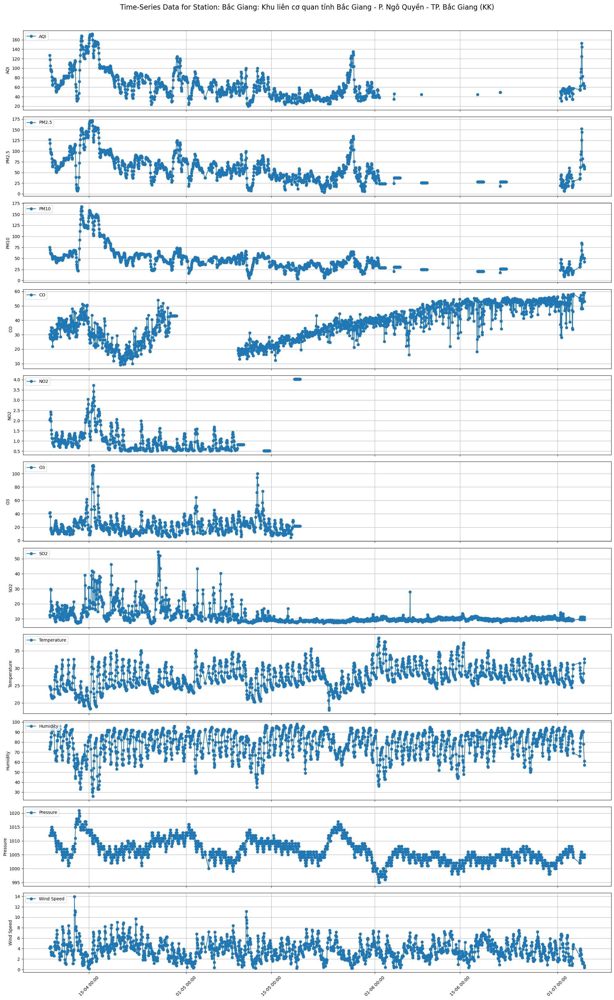

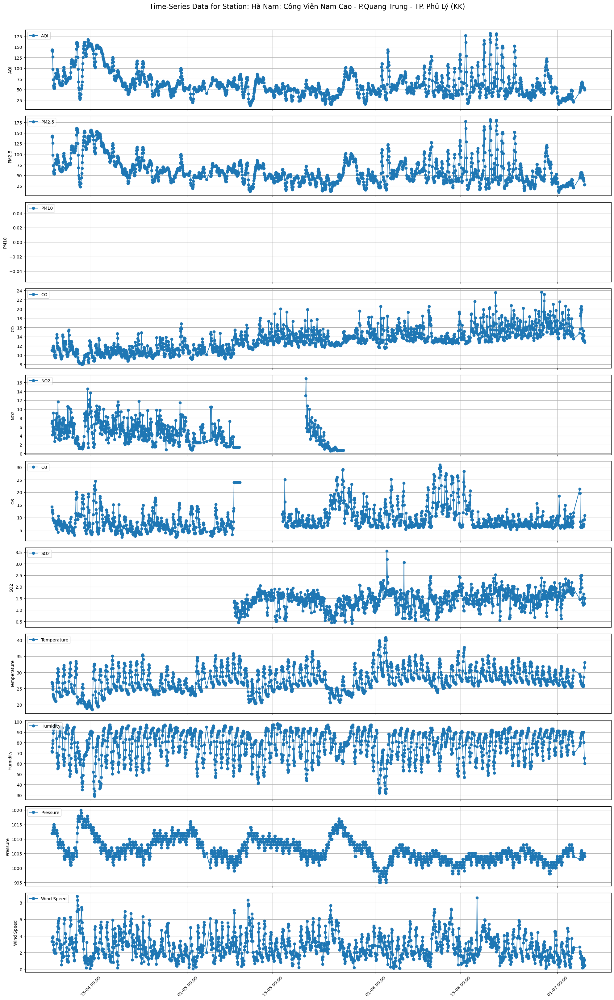

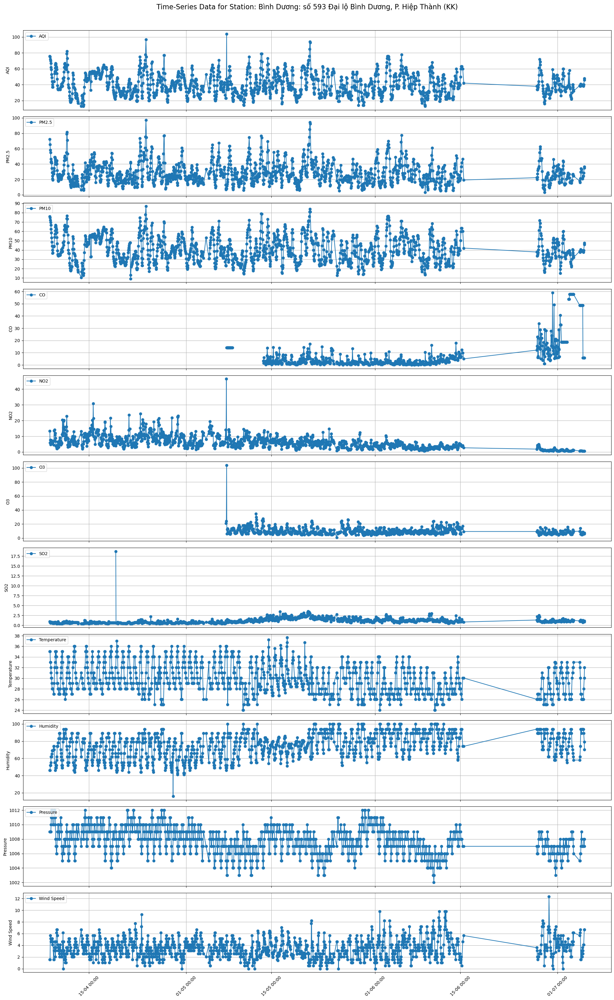

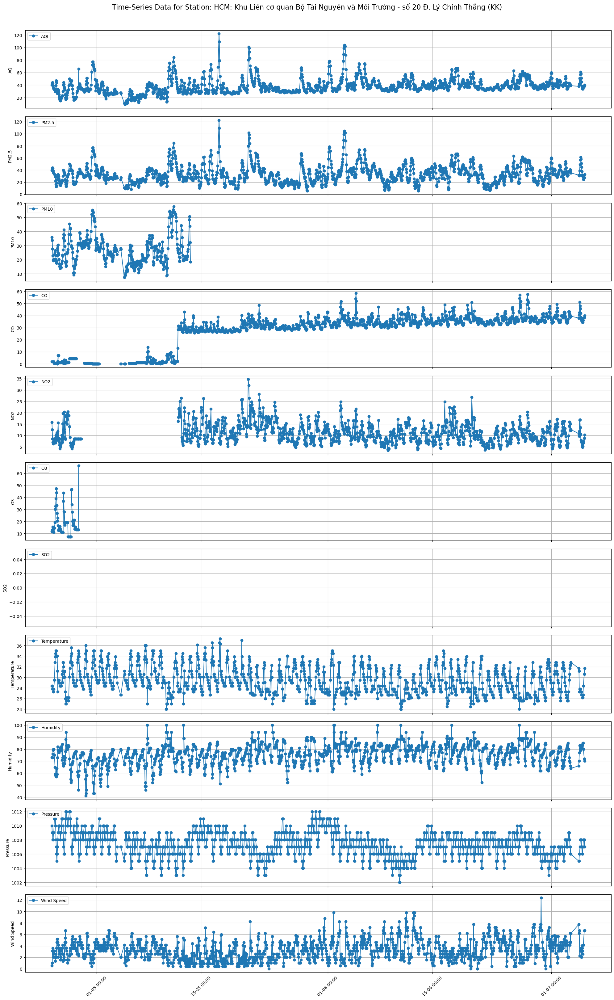

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import os

# Tạo thư mục output/time-series nếu chưa tồn tại
output_dir = 'output/time-series'
os.makedirs(output_dir, exist_ok=True)

# Đọc dữ liệu
df = pd.read_csv('./air_quality_weather_data_filtered.csv', parse_dates=['Timestamp'], dayfirst=True)

# Chuyển các cột cần thiết về số
columns_to_plot = ['AQI', 'PM2.5', 'PM10', 'CO', 'NO2', 'O3', 'SO2',
                   'Temperature', 'Humidity', 'Pressure', 'Wind Speed']
for col in columns_to_plot:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Lấy danh sách trạm
station_names = df['Name'].unique()

# Vẽ biểu đồ cho từng trạm
for name in station_names:
    station_data = df[df['Name'] == name].copy()
    station_data.sort_values('Timestamp', inplace=True)

    fig, axes = plt.subplots(nrows=len(columns_to_plot), ncols=1, figsize=(20, 3 * len(columns_to_plot)), sharex=True)
    fig.suptitle(f'Time-Series Data for Station: {name}', fontsize=16)

    for i, col in enumerate(columns_to_plot):
        ax = axes[i]
        ax.plot(station_data['Timestamp'], station_data[col], marker='o', linestyle='-', label=col)
        ax.set_ylabel(col)
        ax.grid(True)
        ax.legend(loc='upper left')
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m %H:%M'))

    plt.xticks(rotation=45)
    plt.tight_layout(rect=[0, 0, 1, 0.97])  # Chừa chỗ cho title
    
    # Lưu biểu đồ vào thư mục output/time-series
    safe_name = name.replace(' ', '_').replace('/', '_')  # Thay thế ký tự không hợp lệ trong tên file
    plt.savefig(os.path.join(output_dir, f'time_series_{safe_name}.png'))
    plt.show()

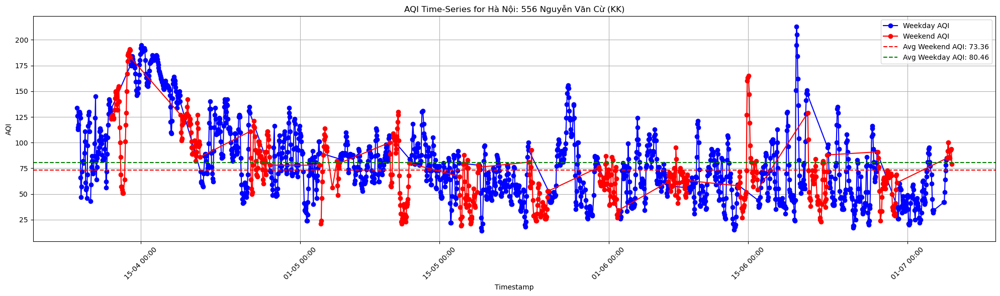


Phân tích AQI cho trạm Hà Nội: 556 Nguyễn Văn Cừ (KK):
- Trung bình AQI ngày cuối tuần: 73.36
- Trung bình AQI ngày trong tuần: 80.46
- Sự khác biệt: -7.11
- Số lượng ngày cuối tuần: 503
- Số lượng ngày trong tuần: 1356


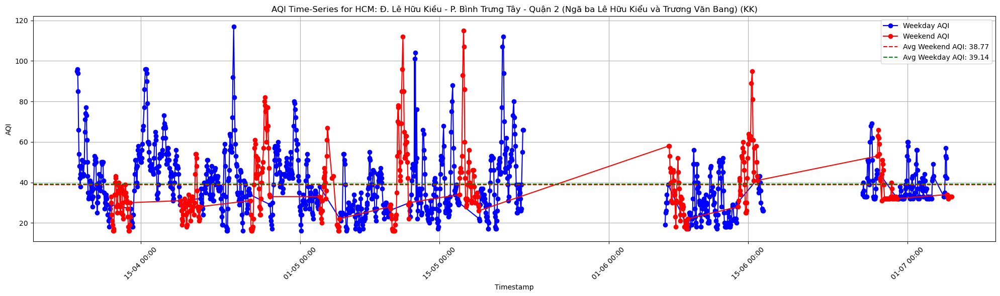


Phân tích AQI cho trạm HCM: Đ. Lê Hữu Kiều - P. Bình Trưng Tây - Quận 2 (Ngã ba Lê Hữu Kiểu và Trương Văn Bang) (KK):
- Trung bình AQI ngày cuối tuần: 38.77
- Trung bình AQI ngày trong tuần: 39.14
- Sự khác biệt: -0.36
- Số lượng ngày cuối tuần: 376
- Số lượng ngày trong tuần: 972


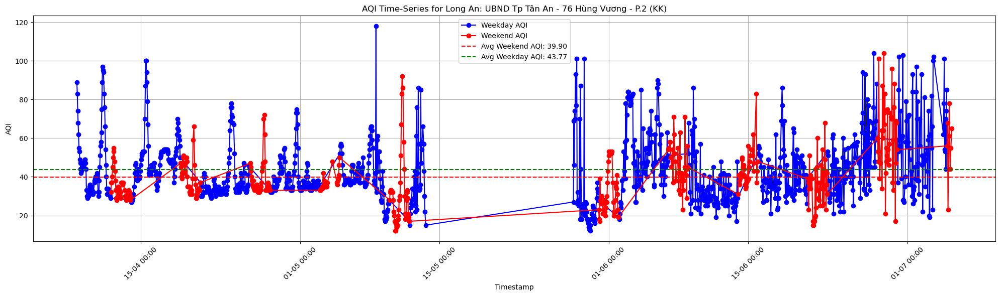


Phân tích AQI cho trạm Long An: UBND Tp Tân An - 76 Hùng Vương - P.2 (KK):
- Trung bình AQI ngày cuối tuần: 39.90
- Trung bình AQI ngày trong tuần: 43.77
- Sự khác biệt: -3.87
- Số lượng ngày cuối tuần: 407
- Số lượng ngày trong tuần: 1094


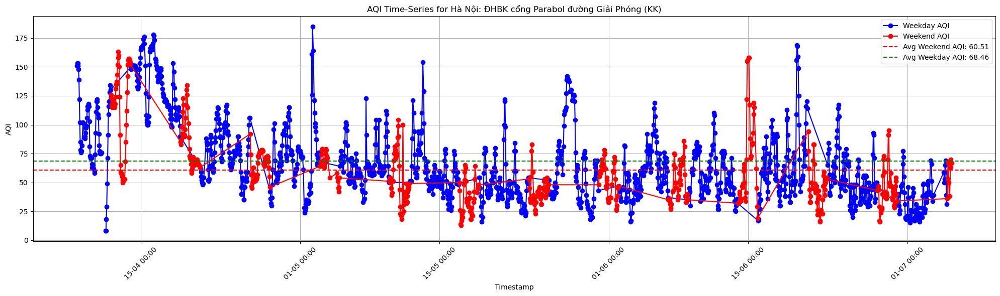


Phân tích AQI cho trạm Hà Nội: ĐHBK cổng Parabol đường Giải Phóng (KK):
- Trung bình AQI ngày cuối tuần: 60.51
- Trung bình AQI ngày trong tuần: 68.46
- Sự khác biệt: -7.96
- Số lượng ngày cuối tuần: 498
- Số lượng ngày trong tuần: 1344


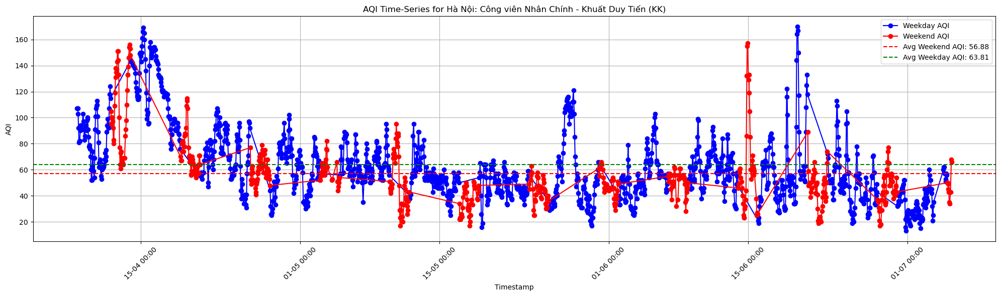


Phân tích AQI cho trạm Hà Nội: Công viên Nhân Chính - Khuất Duy Tiến (KK):
- Trung bình AQI ngày cuối tuần: 56.88
- Trung bình AQI ngày trong tuần: 63.81
- Sự khác biệt: -6.93
- Số lượng ngày cuối tuần: 502
- Số lượng ngày trong tuần: 1358


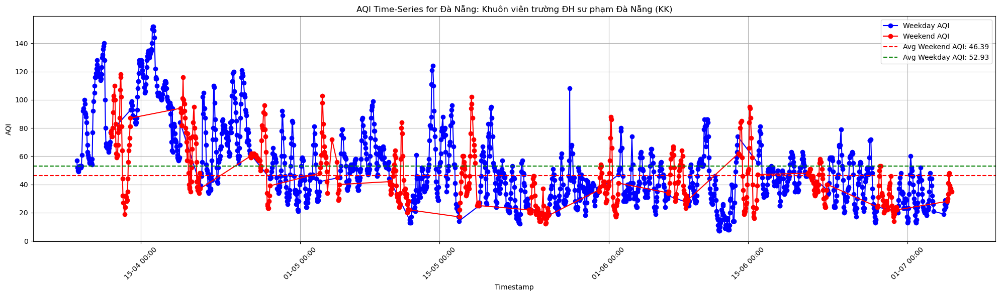


Phân tích AQI cho trạm Đà Nẵng: Khuôn viên trường ĐH sư phạm Đà Nẵng (KK):
- Trung bình AQI ngày cuối tuần: 46.39
- Trung bình AQI ngày trong tuần: 52.93
- Sự khác biệt: -6.54
- Số lượng ngày cuối tuần: 502
- Số lượng ngày trong tuần: 1366


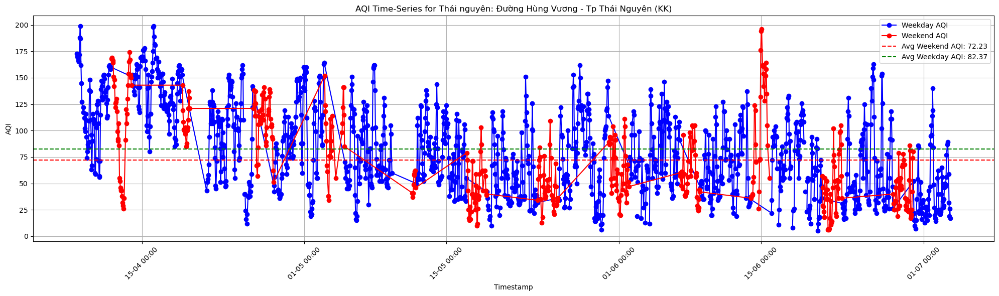


Phân tích AQI cho trạm Thái nguyên: Đường Hùng Vương - Tp Thái Nguyên (KK):
- Trung bình AQI ngày cuối tuần: 72.23
- Trung bình AQI ngày trong tuần: 82.37
- Sự khác biệt: -10.14
- Số lượng ngày cuối tuần: 419
- Số lượng ngày trong tuần: 1320


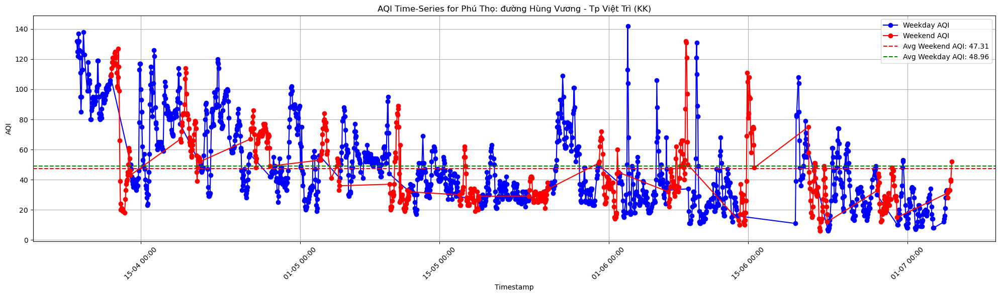


Phân tích AQI cho trạm Phú Thọ: đường Hùng Vương - Tp Việt Trì (KK):
- Trung bình AQI ngày cuối tuần: 47.31
- Trung bình AQI ngày trong tuần: 48.96
- Sự khác biệt: -1.65
- Số lượng ngày cuối tuần: 492
- Số lượng ngày trong tuần: 1224


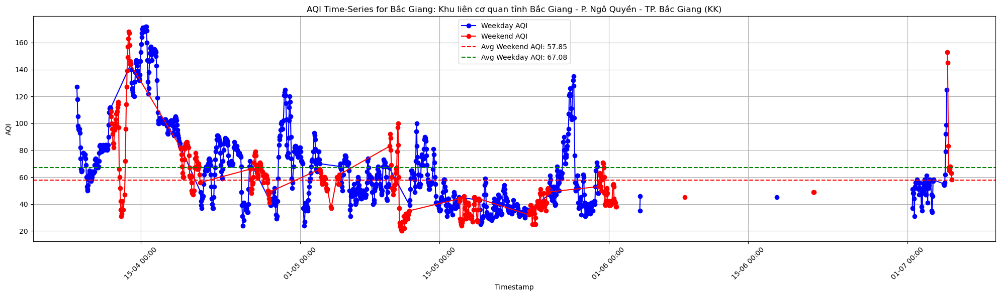


Phân tích AQI cho trạm Bắc Giang: Khu liên cơ quan tỉnh Bắc Giang - P. Ngô Quyền - TP. Bắc Giang (KK):
- Trung bình AQI ngày cuối tuần: 57.85
- Trung bình AQI ngày trong tuần: 67.08
- Sự khác biệt: -9.23
- Số lượng ngày cuối tuần: 498
- Số lượng ngày trong tuần: 1357


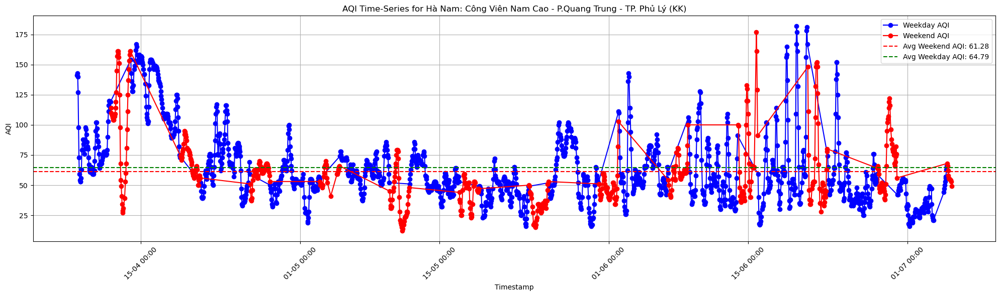


Phân tích AQI cho trạm Hà Nam: Công Viên Nam Cao - P.Quang Trung - TP. Phủ Lý (KK):
- Trung bình AQI ngày cuối tuần: 61.28
- Trung bình AQI ngày trong tuần: 64.79
- Sự khác biệt: -3.50
- Số lượng ngày cuối tuần: 501
- Số lượng ngày trong tuần: 1354


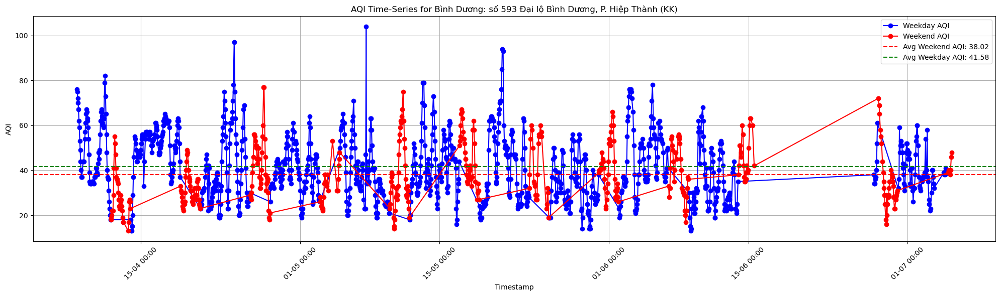


Phân tích AQI cho trạm Bình Dương: số 593 Đại lộ Bình Dương, P. Hiệp Thành (KK):
- Trung bình AQI ngày cuối tuần: 38.02
- Trung bình AQI ngày trong tuần: 41.58
- Sự khác biệt: -3.56
- Số lượng ngày cuối tuần: 399
- Số lượng ngày trong tuần: 1095


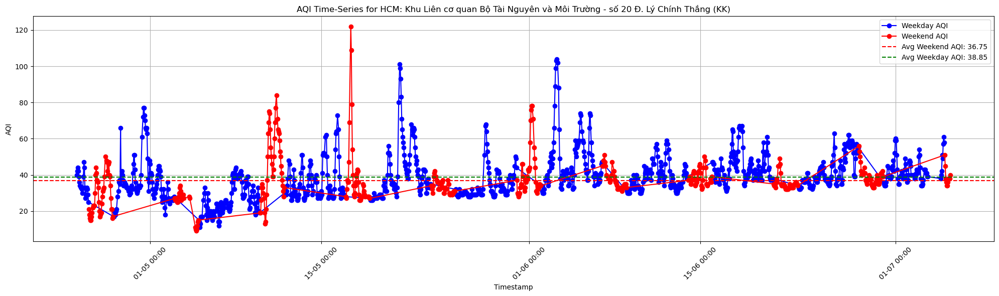


Phân tích AQI cho trạm HCM: Khu Liên cơ quan Bộ Tài Nguyên và Môi Trường - số 20 Đ. Lý Chính Thắng (KK):
- Trung bình AQI ngày cuối tuần: 36.75
- Trung bình AQI ngày trong tuần: 38.85
- Sự khác biệt: -2.09
- Số lượng ngày cuối tuần: 413
- Số lượng ngày trong tuần: 1084


In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np
from datetime import datetime
import os

# Tạo thư mục output/compare_day_of_week nếu chưa tồn tại
output_dir = 'output/compare_day_of_week'
os.makedirs(output_dir, exist_ok=True)

# Đọc dữ liệu và chuyển Timestamp thành datetime
df = pd.read_csv('./air_quality_weather_data_filtered.csv', parse_dates=['Timestamp'], dayfirst=True)

# Chuyển AQI về dạng số
df['AQI'] = pd.to_numeric(df['AQI'], errors='coerce')

# Tạo cột 'DayOfWeek' để xác định ngày trong tuần (0 = Thứ Hai, 6 = Chủ Nhật)
df['DayOfWeek'] = df['Timestamp'].dt.dayofweek

# Phân loại ngày: 5 = Thứ Bảy, 6 = Chủ Nhật
df['IsWeekend'] = df['DayOfWeek'].isin([5, 6])

# Lấy danh sách các trạm đo duy nhất
station_names = df['Name'].unique()

# Danh sách để lưu kết quả phân tích
analysis_results = []

# Vòng lặp qua từng trạm
for name in station_names:
    station_data = df[df['Name'] == name].copy()
    station_data.sort_values('Timestamp', inplace=True)

    # Tách dữ liệu thành ngày trong tuần và ngày cuối tuần
    weekday_data = station_data[~station_data['IsWeekend']].copy()
    weekend_data = station_data[station_data['IsWeekend']].copy()

    # Tính trung bình AQI cho ngày cuối tuần và ngày trong tuần
    avg_aqi_weekend = weekend_data['AQI'].mean()
    avg_aqi_weekday = weekday_data['AQI'].mean()

    # Lưu kết quả phân tích vào danh sách
    analysis_results.append({
        'Station': name,
        'Avg_Weekend_AQI': avg_aqi_weekend,
        'Avg_Weekday_AQI': avg_aqi_weekday,
        'AQI_Difference': avg_aqi_weekend - avg_aqi_weekday,
        'Weekend_Count': len(weekend_data),
        'Weekday_Count': len(weekday_data)
    })

    # Vẽ biểu đồ thời gian
    plt.figure(figsize=(20, 6))
    
    # Vẽ đường AQI cho ngày trong tuần (màu xanh)
    if not weekday_data.empty:
        plt.plot(weekday_data['Timestamp'], weekday_data['AQI'], marker='o', linestyle='-', color='blue', label='Weekday AQI')
    
    # Vẽ đường AQI cho ngày cuối tuần (màu đỏ)
    if not weekend_data.empty:
        plt.plot(weekend_data['Timestamp'], weekend_data['AQI'], marker='o', linestyle='-', color='red', label='Weekend AQI')

    plt.title(f'AQI Time-Series for {name}')
    plt.xlabel('Timestamp')
    plt.ylabel('AQI')
    plt.grid(True)
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m %H:%M'))
    plt.xticks(rotation=45)
    plt.tight_layout()

    # Thêm đường ngang cho trung bình ngày cuối tuần và ngày trong tuần
    if not np.isnan(avg_aqi_weekend):
        plt.axhline(y=avg_aqi_weekend, color='red', linestyle='--', label=f'Avg Weekend AQI: {avg_aqi_weekend:.2f}')
    if not np.isnan(avg_aqi_weekday):
        plt.axhline(y=avg_aqi_weekday, color='green', linestyle='--', label=f'Avg Weekday AQI: {avg_aqi_weekday:.2f}')

    plt.legend()
    
    # Lưu biểu đồ vào thư mục output/compare_day_of_week
    safe_name = name.replace(' ', '_').replace('/', '_')  # Thay thế ký tự không hợp lệ trong tên file
    plt.savefig(os.path.join(output_dir, f'aqi_time_series_{safe_name}.png'))
    plt.show()

    # In kết quả phân tích
    print(f"\nPhân tích AQI cho trạm {name}:")
    print(f"- Trung bình AQI ngày cuối tuần: {avg_aqi_weekend:.2f}")
    print(f"- Trung bình AQI ngày trong tuần: {avg_aqi_weekday:.2f}")
    print(f"- Sự khác biệt: {(avg_aqi_weekend - avg_aqi_weekday):.2f}")
    print(f"- Số lượng ngày cuối tuần: {len(weekend_data)}")
    print(f"- Số lượng ngày trong tuần: {len(weekday_data)}")

# Lưu kết quả phân tích vào file CSV
analysis_df = pd.DataFrame(analysis_results)
analysis_df.to_csv(os.path.join(output_dir, 'aqi_analysis_summary.csv'), index=False)

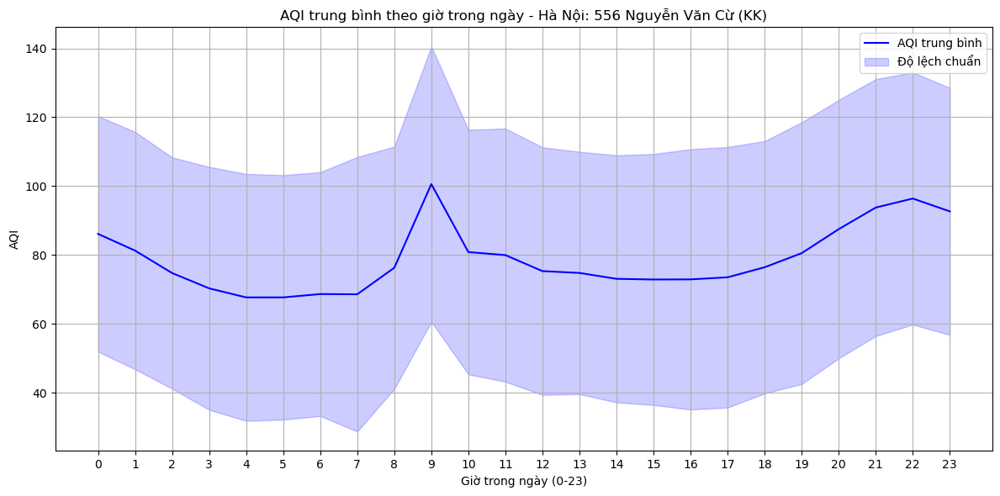

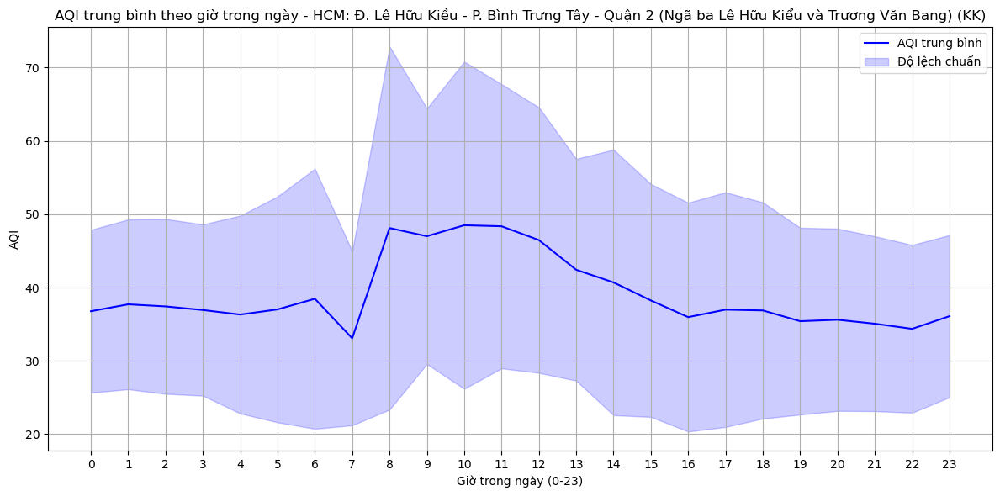

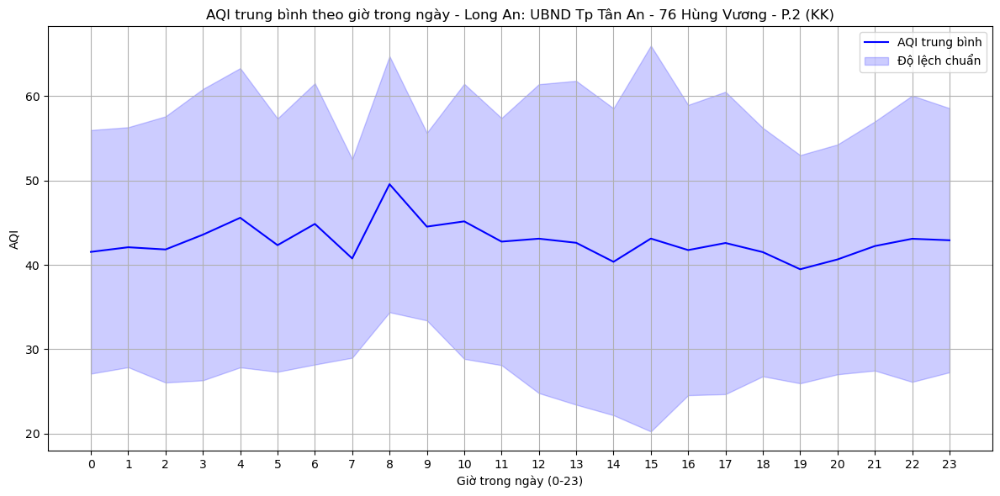

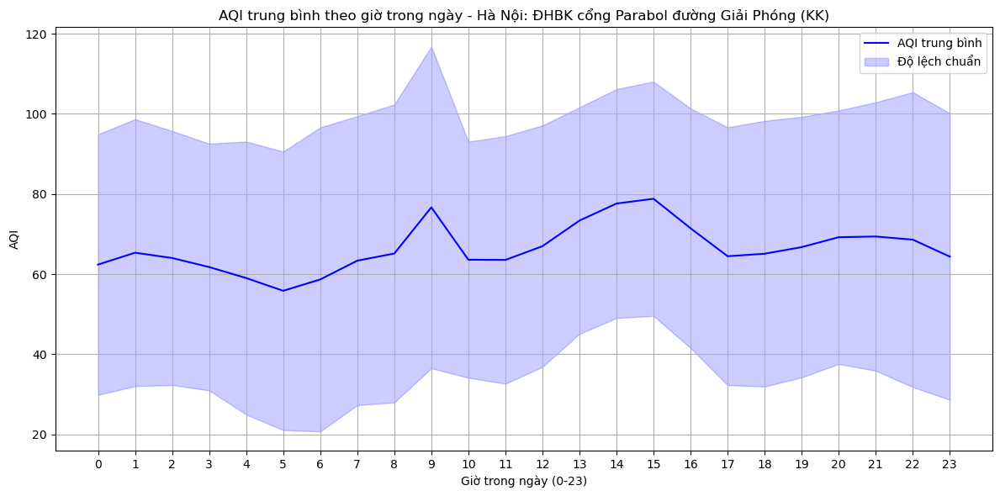

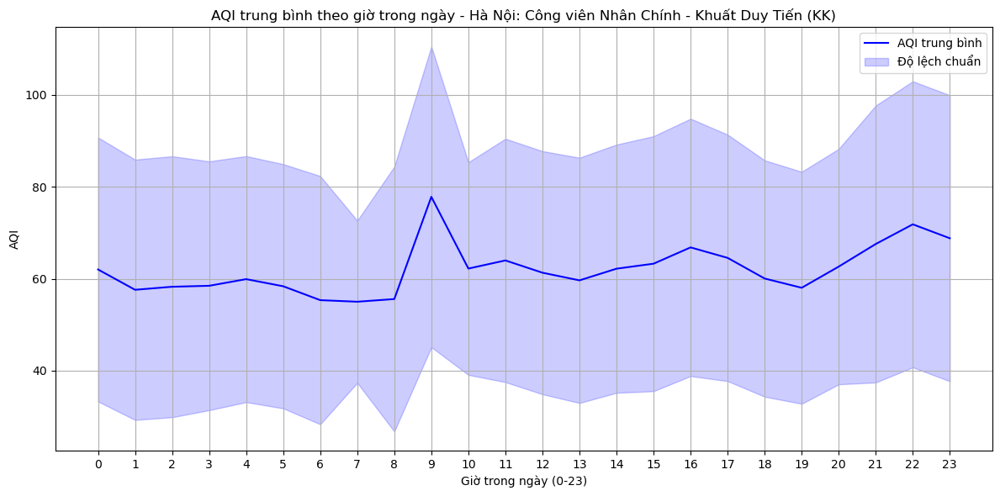

...

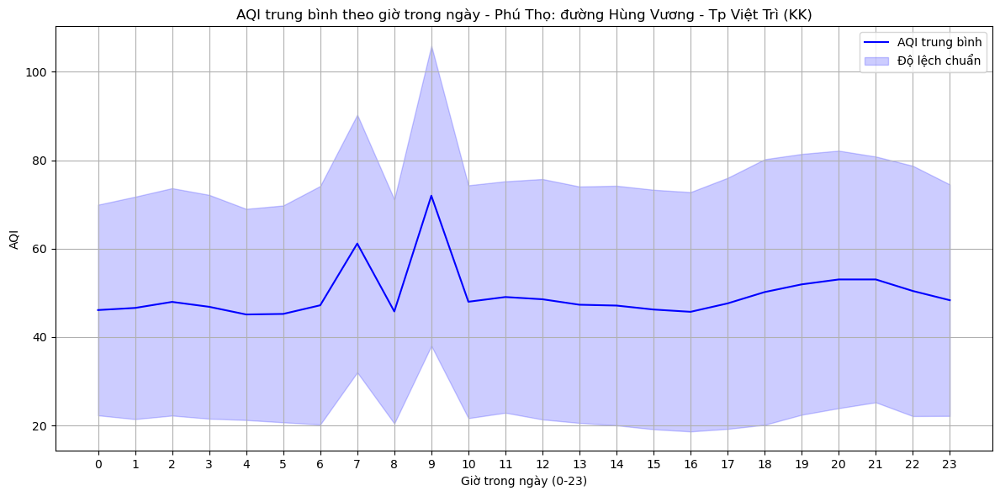

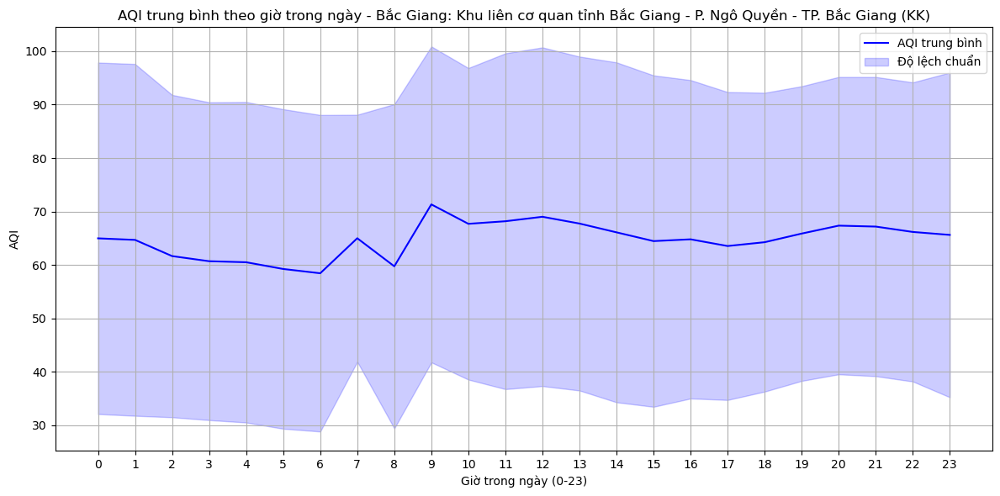

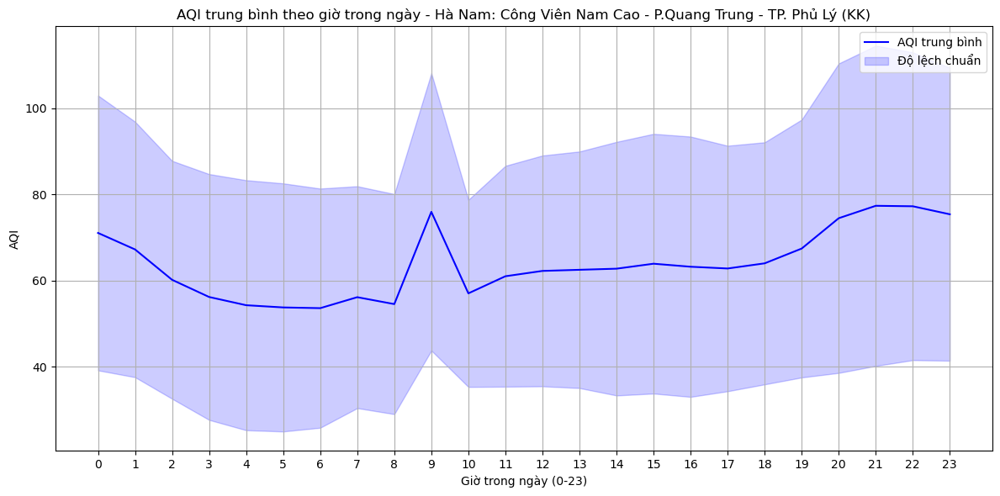

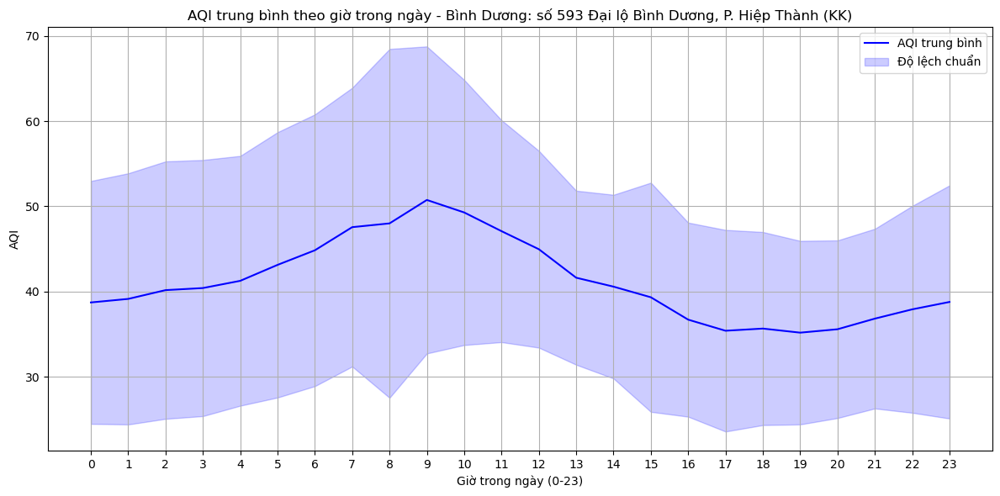

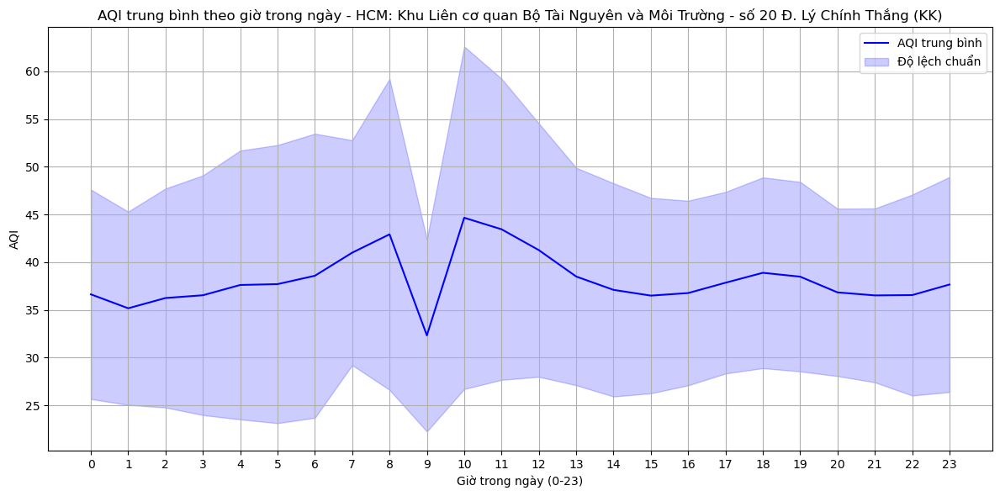

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os

# Tạo thư mục output/avg_std_hour_of_day nếu chưa tồn tại
output_dir = 'output/avg_std_hour_of_day'
os.makedirs(output_dir, exist_ok=True)

# Đọc dữ liệu
df = pd.read_csv('./air_quality_weather_data_filtered.csv', parse_dates=['Timestamp'], dayfirst=True)

# Chuyển AQI về dạng số
df['AQI'] = pd.to_numeric(df['AQI'], errors='coerce')

# Loại bỏ dòng thiếu dữ liệu
df = df.dropna(subset=['AQI'])

# Tạo cột Hour (giờ trong ngày)
df['Hour'] = df['Timestamp'].dt.hour

# Lấy danh sách trạm đo
stations = df['Name'].unique()

# Vòng lặp cho từng trạm
for station in stations:
    station_data = df[df['Name'] == station]

    # Tính trung bình và độ lệch chuẩn theo giờ
    grouped = station_data.groupby('Hour').agg({
        'AQI': ['mean', 'std'],
    }).reset_index()
    grouped.columns = ['Hour', 'AQI_mean', 'AQI_std']

    # Vẽ biểu đồ AQI
    plt.figure(figsize=(12, 6))
    plt.plot(grouped['Hour'], grouped['AQI_mean'], label='AQI trung bình', color='blue')
    plt.fill_between(grouped['Hour'],
                     grouped['AQI_mean'] - grouped['AQI_std'],
                     grouped['AQI_mean'] + grouped['AQI_std'],
                     color='blue', alpha=0.2, label='Độ lệch chuẩn')
    plt.title(f"AQI trung bình theo giờ trong ngày - {station}")
    plt.xlabel("Giờ trong ngày (0-23)")
    plt.ylabel("AQI")
    plt.xticks(range(0, 24))
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    
    # Lưu biểu đồ vào thư mục output/avg_std_hour_of_day
    safe_name = station.replace(' ', '_').replace('/', '_')  # Thay thế ký tự không hợp lệ trong tên file
    plt.savefig(os.path.join(output_dir, f'aqi_hourly_avg_std_{safe_name}.png'))
    plt.show()

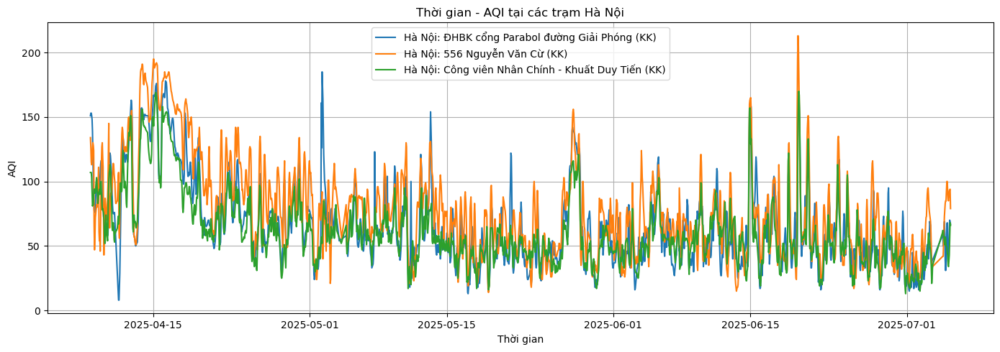

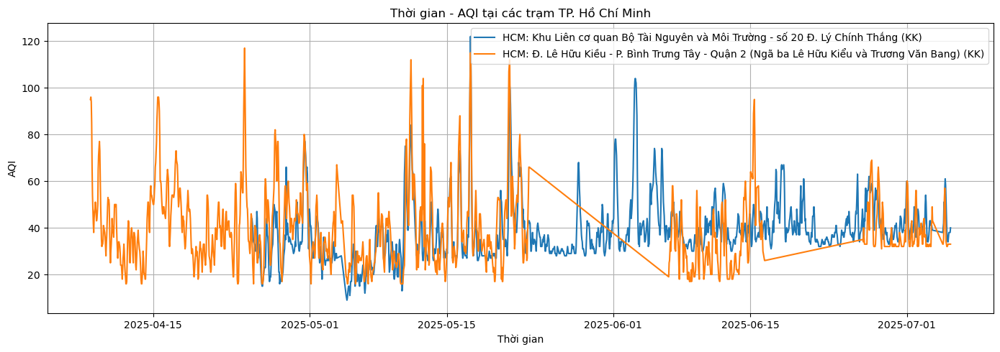

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Tạo thư mục output/compare_intracity nếu chưa tồn tại
output_dir = 'output/compare_intracity'
os.makedirs(output_dir, exist_ok=True)

# Đọc dữ liệu
df = pd.read_csv('./air_quality_weather_data_filtered.csv', parse_dates=['Timestamp'], dayfirst=True)

# Chuyển AQI về số và loại bỏ giá trị thiếu
df['AQI'] = pd.to_numeric(df['AQI'], errors='coerce')
df = df.dropna(subset=['AQI'])

# Nhóm trạm theo khu vực
stations_hanoi = [
    "Hà Nội: ĐHBK cổng Parabol đường Giải Phóng (KK)",
    "Hà Nội: 556 Nguyễn Văn Cừ (KK)",
    "Hà Nội: Công viên Nhân Chính - Khuất Duy Tiến (KK)"
]

stations_hcm = [
    "HCM: Khu Liên cơ quan Bộ Tài Nguyên và Môi Trường - số 20 Đ. Lý Chính Thắng (KK)",
    "HCM: Đ. Lê Hữu Kiều - P. Bình Trưng Tây - Quận 2 (Ngã ba Lê Hữu Kiểu và Trương Văn Bang) (KK)"
]

# Hà Nội - Time Series
plt.figure(figsize=(14, 5))
for station in stations_hanoi:
    data = df[df['Name'] == station].sort_values('Timestamp')
    plt.plot(data['Timestamp'], data['AQI'], label=station)
plt.title("Thời gian - AQI tại các trạm Hà Nội")
plt.xlabel("Thời gian")
plt.ylabel("AQI")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, 'aqi_time_series_hanoi.png'))
plt.show()

# TP.HCM - Time Series
plt.figure(figsize=(14, 5))
for station in stations_hcm:
    data = df[df['Name'] == station].sort_values('Timestamp')
    plt.plot(data['Timestamp'], data['AQI'], label=station)
plt.title("Thời gian - AQI tại các trạm TP. Hồ Chí Minh")
plt.xlabel("Thời gian")
plt.ylabel("AQI")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, 'aqi_time_series_hcm.png'))
plt.show()

/var/folders/pb/pq2vvvgd0tq_7_xbc73hj7680000gn/T/ipykernel_62180/854306446.py:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  'Miền Bắc': get_cmap('Blues'),
/var/folders/pb/pq2vvvgd0tq_7_xbc73hj7680000gn/T/ipykernel_62180/854306446.py:38: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  'Miền Nam': get_cmap('Reds')


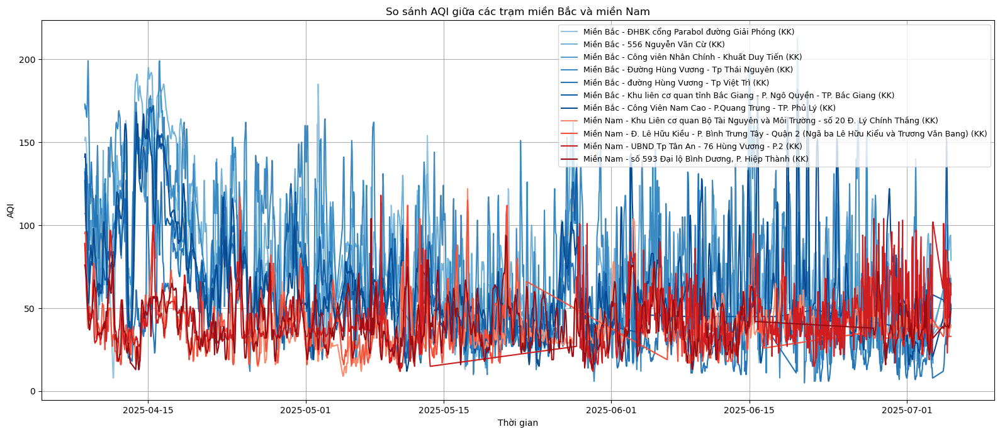

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.cm import get_cmap
import os

# Tạo thư mục output/compare_region nếu chưa tồn tại
output_dir = 'output/compare_region'
os.makedirs(output_dir, exist_ok=True)

# Đọc dữ liệu
df = pd.read_csv('./air_quality_weather_data_filtered.csv', parse_dates=['Timestamp'], dayfirst=True)
df['AQI'] = pd.to_numeric(df['AQI'], errors='coerce')
df = df.dropna(subset=['AQI'])

# Danh sách trạm theo miền
stations_by_region = {
    'Miền Bắc': [
        "Hà Nội: ĐHBK cổng Parabol đường Giải Phóng (KK)",
        "Hà Nội: 556 Nguyễn Văn Cừ (KK)",
        "Hà Nội: Công viên Nhân Chính - Khuất Duy Tiến (KK)",
        "Thái nguyên: Đường Hùng Vương - Tp Thái Nguyên (KK)",
        "Phú Thọ: đường Hùng Vương - Tp Việt Trì (KK)",
        "Bắc Giang: Khu liên cơ quan tỉnh Bắc Giang - P. Ngô Quyền - TP. Bắc Giang (KK)",
        "Hà Nam: Công Viên Nam Cao - P.Quang Trung - TP. Phủ Lý (KK)"
    ],
    'Miền Nam': [
        "HCM: Khu Liên cơ quan Bộ Tài Nguyên và Môi Trường - số 20 Đ. Lý Chính Thắng (KK)",
        "HCM: Đ. Lê Hữu Kiều - P. Bình Trưng Tây - Quận 2 (Ngã ba Lê Hữu Kiểu và Trương Văn Bang) (KK)",
        "Long An: UBND Tp Tân An - 76 Hùng Vương - P.2 (KK)",
        "Bình Dương: số 593 Đại lộ Bình Dương, P. Hiệp Thành (KK)"
    ]
}

# Colormap cho từng miền
region_cmaps = {
    'Miền Bắc': get_cmap('Blues'),
    'Miền Nam': get_cmap('Reds')
}

plt.figure(figsize=(16, 7))

for region, stations in stations_by_region.items():
    cmap = region_cmaps[region]
    colors = cmap(np.linspace(0.4, 0.9, len(stations)))  # Tạo màu với độ đậm nhạt khác nhau

    for i, station in enumerate(stations):
        data = df[df['Name'] == station].sort_values('Timestamp')
        if data.empty:
            continue  # Bỏ qua nếu không có dữ liệu
        label = f"{region} - {station.split(':')[1].strip()}"
        plt.plot(data['Timestamp'], data['AQI'], label=label, color=colors[i])

# Tuỳ chỉnh biểu đồ
plt.title("So sánh AQI giữa các trạm miền Bắc và miền Nam")
plt.xlabel("Thời gian")
plt.ylabel("AQI")
plt.legend(loc='upper right', fontsize=9)
plt.grid(True)
plt.tight_layout()

# Lưu biểu đồ vào thư mục output/compare_region
plt.savefig(os.path.join(output_dir, 'aqi_compare_region.png'))
plt.show()

📊 PHÂN TÍCH THỐNG KÊ THEO KHU VỰC

Tổng số khu vực: 3
Danh sách khu vực: Miền Bắc, Miền Nam, Không xác định

🏢 KHU VỰC: Miền Bắc
Tổng số bản ghi: 12726
Thời gian từ: 2025-04-08 14:00:00 đến 2025-07-05 11:00:00
Tỷ lệ NaN trong mỗi cột:
  AQI: 5.3%
  PM2.5: 4.0%
  PM10: 20.7%
  CO: 6.6%
  NO2: 48.6%
  O3: 24.4%
  SO2: 11.9%
  Temperature: 0.0%
  Humidity: 0.0%
  Pressure: 0.0%
  Wind Speed: 0.0%

📈 THỐNG KÊ TỔNG QUÁT:
AQI: Mean=66.33, Std=34.34, Min=5.00, Max=213.00, Vượt ngưỡng (>100)=15.65%, Số mẫu hợp lệ=12053
PM2.5: Mean=64.65, Std=35.18, Min=1.26, Max=212.63, Số mẫu hợp lệ=12214
PM10: Mean=48.00, Std=24.71, Min=1.54, Max=173.99, Số mẫu hợp lệ=10086
CO: Mean=13.98, Std=11.60, Min=0.29, Max=59.04, Số mẫu hợp lệ=11885
NO2: Mean=8.89, Std=9.99, Min=0.04, Max=76.23, Số mẫu hợp lệ=6541
O3: Mean=15.91, Std=15.73, Min=0.49, Max=177.59, Số mẫu hợp lệ=9619
SO2: Mean=6.02, Std=5.41, Min=0.40, Max=54.84, Số mẫu hợp lệ=11216
Temperature: Mean=27.54, Std=3.44, Min=17.73, Max=40.81, Số mẫu hợp lệ=

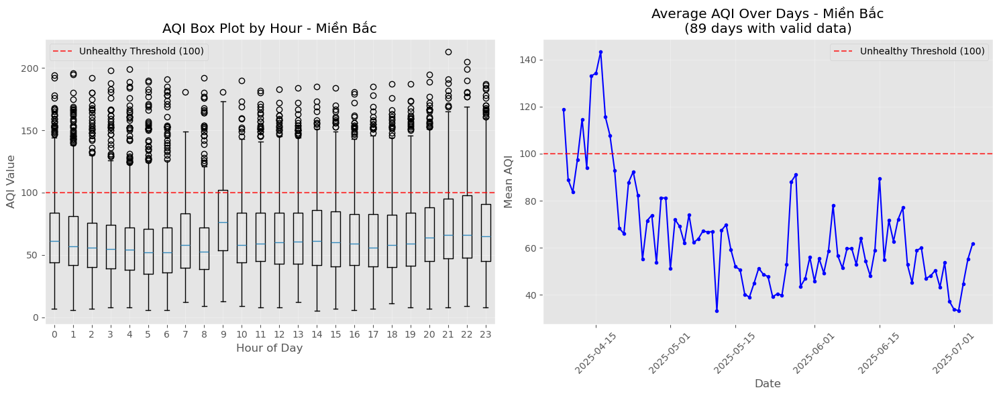


🏢 KHU VỰC: Miền Nam
Tổng số bản ghi: 5840
Thời gian từ: 2025-04-08 14:00:00 đến 2025-07-05 11:00:00
Tỷ lệ NaN trong mỗi cột:
  AQI: 0.1%
  PM2.5: 0.0%
  PM10: 18.9%
  CO: 26.4%
  NO2: 44.8%
  O3: 68.7%
  SO2: 25.7%
  Temperature: 0.0%
  Humidity: 0.0%
  Pressure: 0.0%
  Wind Speed: 0.0%

📈 THỐNG KÊ TỔNG QUÁT:
AQI: Mean=40.19, Std=14.83, Min=9.00, Max=122.00, Vượt ngưỡng (>100)=0.43%, Số mẫu hợp lệ=5836
PM2.5: Mean=32.21, Std=15.73, Min=2.80, Max=122.47, Số mẫu hợp lệ=5840
PM10: Mean=32.32, Std=13.95, Min=1.72, Max=86.80, Số mẫu hợp lệ=4735
CO: Mean=17.97, Std=14.94, Min=0.01, Max=59.04, Số mẫu hợp lệ=4298
NO2: Mean=7.90, Std=5.94, Min=0.51, Max=103.57, Số mẫu hợp lệ=3223
O3: Mean=9.92, Std=6.42, Min=0.38, Max=117.51, Số mẫu hợp lệ=1827
SO2: Mean=6.63, Std=8.57, Min=0.40, Max=35.50, Số mẫu hợp lệ=4342
Temperature: Mean=29.44, Std=2.77, Min=23.55, Max=38.16, Số mẫu hợp lệ=5840
Humidity: Mean=74.91, Std=11.38, Min=16.00, Max=100.00, Số mẫu hợp lệ=5840
Pressure: Mean=1007.60, Std=1.84, Mi

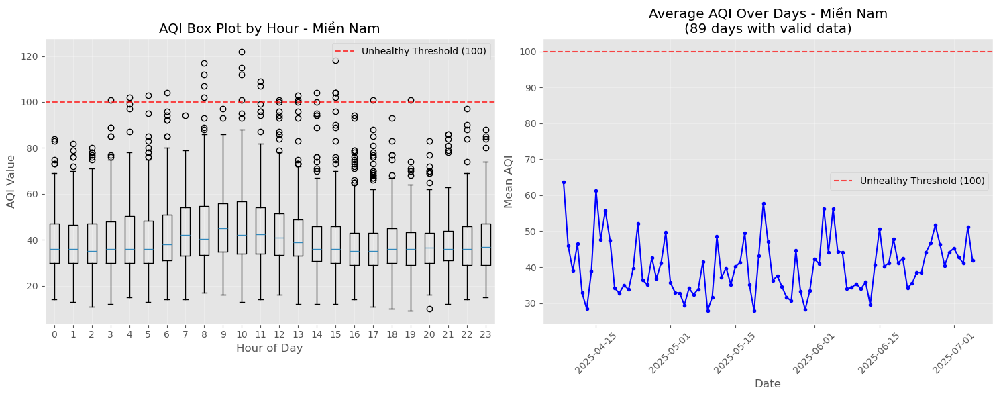


🏢 KHU VỰC: Không xác định
Tổng số bản ghi: 1868
Thời gian từ: 2025-04-08 14:00:00 đến 2025-07-05 11:00:00
Tỷ lệ NaN trong mỗi cột:
  AQI: 0.0%
  PM2.5: 0.0%
  PM10: 0.0%
  CO: 0.0%
  NO2: 0.0%
  O3: 0.0%
  SO2: 0.0%
  Temperature: 0.0%
  Humidity: 0.0%
  Pressure: 0.0%
  Wind Speed: 0.0%

📈 THỐNG KÊ TỔNG QUÁT:
AQI: Mean=51.18, Std=26.49, Min=7.00, Max=152.00, Vượt ngưỡng (>100)=6.64%, Số mẫu hợp lệ=1868
PM2.5: Mean=48.50, Std=26.41, Min=1.28, Max=152.39, Số mẫu hợp lệ=1868
PM10: Mean=41.79, Std=20.55, Min=1.49, Max=135.94, Số mẫu hợp lệ=1868
CO: Mean=10.78, Std=5.03, Min=2.76, Max=36.81, Số mẫu hợp lệ=1868
NO2: Mean=6.68, Std=7.50, Min=0.51, Max=73.83, Số mẫu hợp lệ=1868
O3: Mean=10.31, Std=11.08, Min=0.43, Max=116.27, Số mẫu hợp lệ=1868
SO2: Mean=1.71, Std=0.26, Min=1.12, Max=5.51, Số mẫu hợp lệ=1868
Temperature: Mean=28.33, Std=2.99, Min=21.01, Max=38.01, Số mẫu hợp lệ=1868
Humidity: Mean=77.84, Std=12.39, Min=34.00, Max=100.00, Số mẫu hợp lệ=1868
Pressure: Mean=1007.19, Std=3.09, M

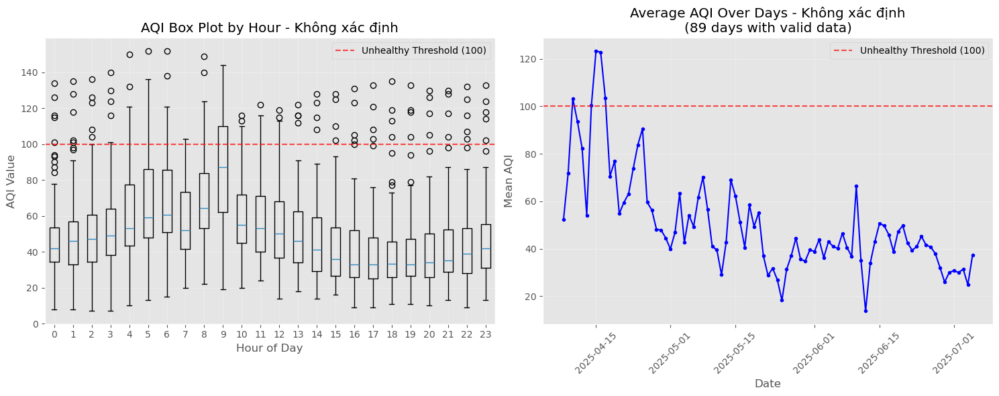


📈 SO SÁNH GIỮA CÁC KHU VỰC

Bảng so sánh AQI giữa các khu vực:
----------------------------------------------------------------------------------------------------
Khu vực         Tổng mẫu   Mẫu hợp lệ   % Thiếu  AQI TB     Độ lệch    Vượt ngưỡng 
----------------------------------------------------------------------------------------------------
Miền Bắc        12726      12053        5.3     % 66.3       34.3       15.6        %
Miền Nam        5840       5836         0.1     % 40.2       14.8       0.4         %
Không xác định  1868       1868         0.0     % 51.2       26.5       6.6         %

Kiểm định t-test độc lập (so sánh AQI trung bình giữa các khu vực):
----------------------------------------------------------------------------------------------------
Miền Bắc vs Miền Nam: t=70.99, p-value=0.0000 (Khác biệt có ý nghĩa thống kê)
Miền Bắc vs Không xác định: t=22.02, p-value=0.0000 (Khác biệt có ý nghĩa thống kê)
Miền Nam vs Không xác định: t=-17.08, p-value=0.0000 (Khác b

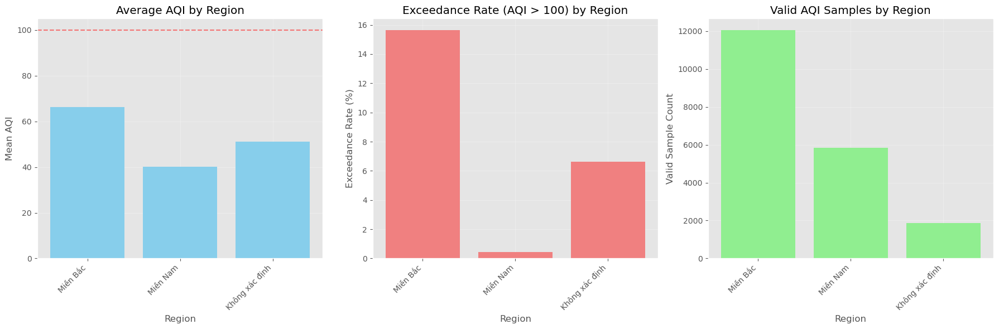

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as sp_stats  # Use distinct alias to avoid conflicts
import os

# Tạo thư mục output/compare_region nếu chưa tồn tại
output_dir = 'output/compare_region'
os.makedirs(output_dir, exist_ok=True)

# Thiết lập style cho biểu đồ
plt.style.use('ggplot')

# Đọc dữ liệu
df = pd.read_csv('air_quality_weather_data_filtered.csv', parse_dates=['Timestamp'], dayfirst=True)

# Chuyển các cột chỉ số môi trường về dạng số
columns_to_numeric = ['AQI', 'PM2.5', 'PM10', 'CO', 'NO2', 'O3', 'SO2', 'Temperature', 'Humidity', 'Pressure', 'Wind Speed']
for col in columns_to_numeric:
    if col in df.columns:
        df[col] = pd.to_numeric(df[col], errors='coerce')

# Loại bỏ các hàng có tất cả chỉ số môi trường đều là NaN
available_indicators = [col for col in columns_to_numeric if col in df.columns]
df = df.dropna(subset=available_indicators, how='all')

# Thêm cột 'Hour' và 'Date'
df['Hour'] = df['Timestamp'].dt.hour
df['Date'] = df['Timestamp'].dt.date

# Hàm phân loại khu vực
def get_region(name):
    if any(region in name for region in ['Hà Nội', 'Thái Nguyên', 'Phú Thọ', 'Bắc Giang', 'Hà Nam']):
        return 'Miền Bắc'
    elif any(region in name for region in ['HCM', 'Long An', 'Bình Dương']):
        return 'Miền Nam'
    else:
        return 'Không xác định'

# Thêm cột 'Region'
df['Region'] = df['Name'].apply(get_region)

# Hàm tính tần suất vượt ngưỡng AQI > 100
def calculate_exceedance_rate(data):
    valid_data = data.dropna()
    if len(valid_data) == 0:
        return 0.0
    return (valid_data > 100).mean() * 100  # Phần trăm vượt ngưỡng

# Hàm tính thống kê an toàn
def safe_stats(data):
    valid_data = data.dropna()
    if len(valid_data) == 0:
        return {'Mean': np.nan, 'Std': np.nan, 'Min': np.nan, 'Max': np.nan, 'Count': 0}
    return {
        'Mean': valid_data.mean(),
        'Std': valid_data.std(),
        'Min': valid_data.min(),
        'Max': valid_data.max(),
        'Count': len(valid_data)
    }

print("="*80)
print("📊 PHÂN TÍCH THỐNG KÊ THEO KHU VỰC")
print("="*80)

# Lấy danh sách các khu vực
regions = df['Region'].unique()
print(f"\nTổng số khu vực: {len(regions)}")
print(f"Danh sách khu vực: {', '.join(regions)}")

# Phân tích theo từng khu vực
for region in regions:
    print(f"\n🏢 KHU VỰC: {region}")
    print("="*50)
    
    # Lọc dữ liệu theo khu vực
    region_data = df[df['Region'] == region].copy()
    
    if len(region_data) == 0:
        print("Không có dữ liệu hợp lệ cho khu vực này.")
        continue
    
    print(f"Tổng số bản ghi: {len(region_data)}")
    print(f"Thời gian từ: {region_data['Timestamp'].min()} đến {region_data['Timestamp'].max()}")
    print(f"Tỷ lệ NaN trong mỗi cột:")
    for col in available_indicators:
        nan_rate = (region_data[col].isna().sum() / len(region_data)) * 100
        print(f"  {col}: {nan_rate:.1f}%")

    # 1. Thống kê mô tả tổng quát
    print(f"\n📈 THỐNG KÊ TỔNG QUÁT:")
    overall_stats = {}
    for indicator in available_indicators:
        stats = safe_stats(region_data[indicator])
        if stats['Count'] > 0:
            exceedance_rate = calculate_exceedance_rate(region_data[indicator]) if indicator == 'AQI' else np.nan
            stats['Exceedance_Rate (%)'] = exceedance_rate
            overall_stats[indicator] = stats
            if indicator == 'AQI':
                print(f"{indicator}: Mean={stats['Mean']:.2f}, Std={stats['Std']:.2f}, "
                      f"Min={stats['Min']:.2f}, Max={stats['Max']:.2f}, "
                      f"Vượt ngưỡng (>100)={exceedance_rate:.2f}%, Số mẫu hợp lệ={stats['Count']}")
            else:
                print(f"{indicator}: Mean={stats['Mean']:.2f}, Std={stats['Std']:.2f}, "
                      f"Min={stats['Min']:.2f}, Max={stats['Max']:.2f}, Số mẫu hợp lệ={stats['Count']}")
        else:
            print(f"{indicator}: Không có dữ liệu hợp lệ")

    # 2. Thống kê theo khung giờ
    print(f"\n⏰ THỐNG KÊ THEO KHUNG GIỜ (Top 5 giờ có AQI cao nhất):")
    if 'AQI' in region_data.columns:
        hourly_stats_list = []
        for hour in range(24):
            hour_data = region_data[region_data['Hour'] == hour]['AQI'].dropna()
            if len(hour_data) > 0:
                stats = {
                    'Hour': hour,
                    'mean': hour_data.mean(),
                    'std': hour_data.std(),
                    'min': hour_data.min(),
                    'max': hour_data.max(),
                    'count': len(hour_data),
                    'exceedance_rate': calculate_exceedance_rate(hour_data)
                }
                hourly_stats_list.append(stats)
        
        if hourly_stats_list:
            hourly_stats_df = pd.DataFrame(hourly_stats_list).set_index('Hour')
            top_hours = hourly_stats_df.sort_values('mean', ascending=False).head(5)
            for hour, row in top_hours.iterrows():
                print(f"  Giờ {hour:02d}: AQI={row['mean']:.1f}±{row['std']:.1f}, "
                      f"Min={row['min']:.1f}, Max={row['max']:.1f}, "
                      f"Vượt ngưỡng={row['exceedance_rate']:.1f}%, Số mẫu={int(row['count'])}")
            # Lưu thống kê theo giờ vào CSV
            hourly_stats_df.to_csv(os.path.join(output_dir, f'hourly_stats_{region.replace(" ", "_")}.csv'))
        else:
            print("  Không có dữ liệu AQI hợp lệ theo giờ")

    # 3. Thống kê theo ngày
    print(f"\n📅 THỐNG KÊ THEO NGÀY (5 ngày có AQI cao nhất):")
    if 'AQI' in region_data.columns:
        daily_stats_list = []
        for date in region_data['Date'].unique():
            date_data = region_data[region_data['Date'] == date]['AQI'].dropna()
            if len(date_data) > 0:
                stats = {
                    'Date': date,
                    'mean': date_data.mean(),
                    'std': date_data.std(),
                    'min': date_data.min(),
                    'max': date_data.max(),
                    'count': len(date_data),
                    'exceedance_rate': calculate_exceedance_rate(date_data)
                }
                daily_stats_list.append(stats)
        
        if daily_stats_list:
            daily_stats_df = pd.DataFrame(daily_stats_list).set_index('Date')
            top_days = daily_stats_df.sort_values('mean', ascending=False).head(5)
            for date, row in top_days.iterrows():
                print(f"  {date}: AQI={row['mean']:.1f}±{row['std']:.1f}, "
                      f"Min={row['min']:.1f}, Max={row['max']:.1f}, "
                      f"Vượt ngưỡng={row['exceedance_rate']:.1f}%, Số mẫu={int(row['count'])}")
            # Lưu thống kê theo ngày vào CSV
            daily_stats_df.to_csv(os.path.join(output_dir, f'daily_stats_{region.replace(" ", "_")}.csv'))
        else:
            print("  Không có dữ liệu AQI hợp lệ theo ngày")

    # 4. Vẽ biểu đồ cho khu vực
    if 'AQI' in region_data.columns and len(region_data) > 0:
        plt.figure(figsize=(15, 6))
        
        # Subplot 1: Box Plot theo giờ
        plt.subplot(1, 2, 1)
        hourly_aqi_data = []
        hours_with_data = []
        for hour in range(24):
            hour_data = region_data[region_data['Hour'] == hour]['AQI'].dropna()
            if len(hour_data) > 0:
                hourly_aqi_data.append(hour_data.values)
                hours_with_data.append(hour)
        
        if hourly_aqi_data:
            plt.boxplot(hourly_aqi_data, labels=hours_with_data)
            plt.title(f'AQI Box Plot by Hour - {region}')
            plt.xlabel('Hour of Day')
            plt.ylabel('AQI Value')
            plt.axhline(y=100, color='red', linestyle='--', alpha=0.7, label='Unhealthy Threshold (100)')
            plt.grid(True, alpha=0.3)
            plt.legend()
        
        # Subplot 2: Đường trung bình AQI theo ngày
        plt.subplot(1, 2, 2)
        daily_mean_aqi = region_data.groupby('Date')['AQI'].mean()
        valid_daily_data = daily_mean_aqi.dropna()
        
        if len(valid_daily_data) > 0:
            plt.plot(valid_daily_data.index, valid_daily_data.values, 
                    marker='o', linestyle='-', color='blue', markersize=3)
            plt.axhline(y=100, color='red', linestyle='--', alpha=0.7, label='Unhealthy Threshold (100)')
            plt.title(f'Average AQI Over Days - {region}\n({len(valid_daily_data)} days with valid data)')
            plt.xlabel('Date')
            plt.ylabel('Mean AQI')
            plt.legend()
            plt.grid(True, alpha=0.3)
            plt.xticks(rotation=45)
        else:
            plt.text(0.5, 0.5, 'No valid AQI data', ha='center', va='center', transform=plt.gca().transAxes)
        
        plt.tight_layout()
        # Lưu biểu đồ khu vực
        plt.savefig(os.path.join(output_dir, f'aqi_plots_{region.replace(" ", "_")}.png'))
        plt.show()

# 5. So sánh giữa các khu vực
print("\n" + "="*80)
print("📈 SO SÁNH GIỮA CÁC KHU VỰC")
print("="*80)

# Tạo DataFrame tóm tắt
region_summary = []
for region in regions:
    region_data = df[df['Region'] == region]
    if len(region_data) > 0 and 'AQI' in region_data.columns:
        total_count = len(region_data)
        valid_aqi_count = region_data['AQI'].dropna().shape[0]
        missing_rate = ((total_count - valid_aqi_count) / total_count) * 100
        
        summary = {
            'Region': region,
            'Total_Count': total_count,
            'Valid_AQI_Count': valid_aqi_count,
            'Missing_Rate': missing_rate,
            'Mean_AQI': region_data['AQI'].mean(),
            'Std_AQI': region_data['AQI'].std(),
            'Exceedance_Rate': calculate_exceedance_rate(region_data['AQI'])
        }
        region_summary.append(summary)

# Tạo DataFrame để so sánh
summary_df = pd.DataFrame(region_summary)
if not summary_df.empty:
    print("\nBảng so sánh AQI giữa các khu vực:")
    print("-" * 100)
    print(f"{'Khu vực':<15} {'Tổng mẫu':<10} {'Mẫu hợp lệ':<12} {'% Thiếu':<8} {'AQI TB':<10} {'Độ lệch':<10} {'Vượt ngưỡng':<12}")
    print("-" * 100)
    
    for _, row in summary_df.iterrows():
        print(f"{row['Region']:<15} {row['Total_Count']:<10} {row['Valid_AQI_Count']:<12} {row['Missing_Rate']:<8.1f}% "
              f"{row['Mean_AQI']:<10.1f} {row['Std_AQI']:<10.1f} {row['Exceedance_Rate']:<12.1f}%")

    # Lưu bảng so sánh vào CSV
    summary_df.to_csv(os.path.join(output_dir, 'region_comparison_summary.csv'), index=False)

    # Kiểm định t-test giữa các cặp khu vực
    print("\nKiểm định t-test độc lập (so sánh AQI trung bình giữa các khu vực):")
    print("-" * 100)
    for i, region1 in enumerate(regions):
        for region2 in regions[i+1:]:
            data1 = df[df['Region'] == region1]['AQI'].dropna()
            data2 = df[df['Region'] == region2]['AQI'].dropna()
            if len(data1) > 1 and len(data2) > 1:
                t_stat, p_value = sp_stats.ttest_ind(data1, data2, equal_var=False, nan_policy='omit')
                print(f"{region1} vs {region2}: t={t_stat:.2f}, p-value={p_value:.4f} "
                      f"({'Khác biệt có ý nghĩa thống kê' if p_value < 0.05 else 'Không có ý nghĩa thống kê'})")
            else:
                print(f"{region1} vs {region2}: Không đủ dữ liệu để thực hiện t-test")

    # Vẽ biểu đồ so sánh
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))
    
    # Biểu đồ 1: AQI trung bình
    ax1.bar(range(len(summary_df)), summary_df['Mean_AQI'], color='skyblue')
    ax1.set_title('Average AQI by Region')
    ax1.set_xlabel('Region')
    ax1.set_ylabel('Mean AQI')
    ax1.set_xticks(range(len(summary_df)))
    ax1.set_xticklabels(summary_df['Region'], rotation=45, ha='right')
    ax1.axhline(y=100, color='red', linestyle='--', alpha=0.50)
    ax1.grid(True, alpha=0.3)
    
    # Biểu đồ 2: Tỷ lệ vượt ngưỡng
    ax2.bar(range(len(summary_df)), summary_df['Exceedance_Rate'], color='lightcoral')
    ax2.set_title('Exceedance Rate (AQI > 100) by Region')
    ax2.set_xlabel('Region')
    ax2.set_ylabel('Exceedance Rate (%)')
    ax2.set_xticks(range(len(summary_df)))
    ax2.set_xticklabels(summary_df['Region'], rotation=45, ha='right')
    ax2.grid(True, alpha=0.3)
    
    # Biểu đồ 3: Số lượng mẫu hợp lệ
    ax3.bar(range(len(summary_df)), summary_df['Valid_AQI_Count'], color='lightgreen')
    ax3.set_title('Valid AQI Samples by Region')
    ax3.set_xlabel('Region')
    ax3.set_ylabel('Valid Sample Count')
    ax3.set_xticks(range(len(summary_df)))
    ax3.set_xticklabels(summary_df['Region'], rotation=45, ha='right')
    ax3.grid(True, alpha=0.3)
    
    plt.tight_layout()
    # Lưu biểu đồ so sánh
    plt.savefig(os.path.join(output_dir, 'region_comparison_plots.png'))
    plt.show()

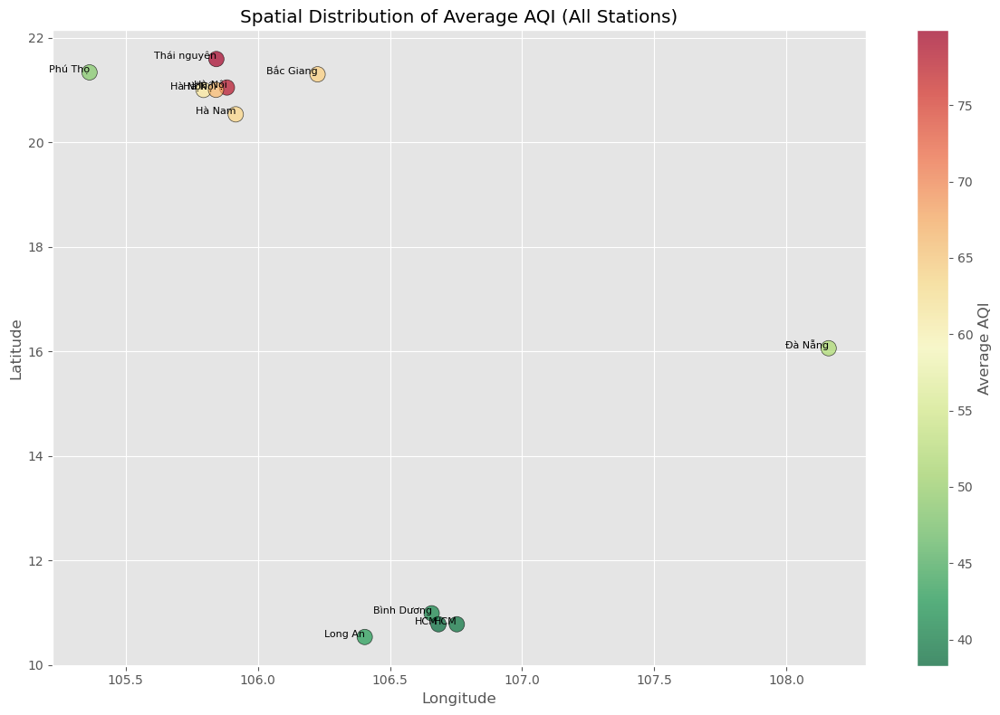

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import os

# Tạo thư mục output/spatial_visualization nếu chưa tồn tại
output_dir = 'output/spatial_visualization'
os.makedirs(output_dir, exist_ok=True)

# Đọc dữ liệu
df = pd.read_csv('./air_quality_weather_data_filtered.csv', parse_dates=['Timestamp'], dayfirst=True)

# Chuyển AQI và tọa độ về dạng số
df['AQI'] = pd.to_numeric(df['AQI'], errors='coerce')
df['Latitude'] = pd.to_numeric(df['Latitude'], errors='coerce')
df['Longitude'] = pd.to_numeric(df['Longitude'], errors='coerce')

# Loại bỏ dòng thiếu dữ liệu quan trọng
df = df.dropna(subset=['AQI', 'Latitude', 'Longitude', 'Name'])

# Tính AQI trung bình cho từng trạm
station_avg_aqi = df.groupby('Name').agg({
    'AQI': 'mean',
    'Latitude': 'first',
    'Longitude': 'first'
}).reset_index()

# === Biểu đồ tĩnh (matplotlib) ===
plt.figure(figsize=(12, 8))
scatter = plt.scatter(
    station_avg_aqi['Longitude'], station_avg_aqi['Latitude'],
    c=station_avg_aqi['AQI'], cmap='RdYlGn_r', s=150, edgecolors='black', alpha=0.7
)
for i, row in station_avg_aqi.iterrows():
    plt.text(row['Longitude'], row['Latitude'], row['Name'].split(':')[0], fontsize=8, ha='right')

plt.colorbar(scatter, label='Average AQI')
plt.title('Spatial Distribution of Average AQI (All Stations)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.tight_layout()
# Lưu biểu đồ tĩnh
plt.savefig(os.path.join(output_dir, 'aqi_spatial_distribution.png'))
plt.show()

# === Biểu đồ tương tác (plotly) ===
fig = px.scatter_geo(
    station_avg_aqi,
    lat='Latitude',
    lon='Longitude',
    color='AQI',
    size='AQI',
    hover_name='Name',
    color_continuous_scale='RdYlGn_r',
    title='Interactive Spatial Distribution of Average AQI (All Stations)'
)
fig.update_layout(
    geo=dict(
        center=dict(lat=15, lon=107),
        projection_scale=5,
        scope='asia',
        showland=True,
        landcolor='LightGray'
    )
)
# Lưu biểu đồ tương tác dưới dạng HTML
fig.write_html(os.path.join(output_dir, 'aqi_spatial_distribution_interactive.html'))
fig.show()